## Import Libraries

In [580]:
import pandas as pd
import numpy as np
from sklearn.model_selection import train_test_split, KFold
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, confusion_matrix, plot_confusion_matrix, precision_recall_fscore_support
import matplotlib.pyplot as plt
from sklearn.svm import SVC

In [335]:
pd.options.display.max_rows = 4000

## Import data

In [336]:
data = pd.read_csv('./train.csv')

## Data Preparation

In [337]:
data = data.drop(['Name', 'Ticket', 'Cabin', 'PassengerId'], axis=1)

# Converting categorical variables into dummy variables
data_processed = pd.get_dummies(data)

# Fill Null Values
data = data_processed.fillna(data_processed.mean())

## Split the dataset

In [338]:
train, test = train_test_split(data, test_size=0.3, random_state=0, stratify=data['Survived'])
X_train = train.drop(['Survived'], axis=1)
Y_train = train['Survived']

X_test = test.drop(['Survived'], axis=1)
Y_test = test['Survived']

## Display the data

In [339]:
print(f'Target: {data.columns[0]}')
print(f'Features: {", ".join(data.columns[1:])}\n')

display(data_processed.head())

Target: Survived
Features: Pclass, Age, SibSp, Parch, Fare, Sex_female, Sex_male, Embarked_C, Embarked_Q, Embarked_S



,Survived,Pclass,Age,SibSp,Parch,Fare,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
0,0,3,22.0,1,0,7.2500,0,1,0,0,1
1,1,1,38.0,1,0,71.2833,1,0,1,0,0
2,1,3,26.0,0,0,7.9250,1,0,0,0,1
3,1,1,35.0,1,0,53.1000,1,0,0,0,1
4,0,3,35.0,0,0,8.0500,0,1,0,0,1


## Training The model Using Random Forest Classifier

In [340]:
# Random Forest
rf = RandomForestClassifier(n_estimators=100)
rf.fit(X_train, Y_train)

RandomForestClassifier()

## Prediction using the trained model

In [341]:
rf_preds = rf.predict(X_test)
print(f'Accuracy of the Random Forest model is: {accuracy_score(Y_test, rf_preds)}')

Accuracy of the Random Forest model is: 0.8171641791044776


## Confusion Matrix for Random Forest

In [342]:
confusion_matrix(Y_test, rf_preds)

array([[148,  17],
       [ 32,  71]])

In [343]:
pd.crosstab(Y_test, rf_preds, rownames=['Actual'], colnames=['Predicted'], margins=True)

Predicted,0,1,All
Actual,,,
0,148,17,165
1,32,71,103
All,180,88,268


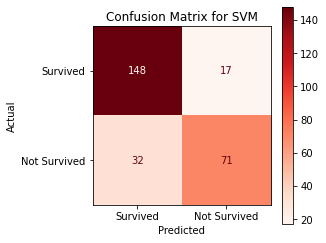

In [345]:
matrix = plot_confusion_matrix(rf, X_test, Y_test, cmap=plt.cm.Reds)
matrix.ax_.set_title('Confusion Matrix for SVM', color='black')
matrix.ax_.set_xticklabels(['Survived', 'Not Survived'])
matrix.ax_.set_yticklabels(['Survived', 'Not Survived'])
plt.xlabel('Predicted', color='black')
plt.ylabel('Actual', color='black')
plt.gcf().axes[0].tick_params(colors='black')
plt.gcf().axes[1].tick_params(colors='black')
plt.gcf().set_size_inches(4, 4)
plt.show()

## Fairness Measures

In [346]:
X_test['Survived'] = Y_test
X_test['rf_preds'] = rf_preds

In [261]:
def get_statistical_parity(pred_column, X_test):
    # Statistical Parity - Male
    pred_survive_and_male = X_test[(X_test[pred_column] == 1) & (X_test['Sex_male'] == 1)].shape[0]
    male = X_test[(X_test['Sex_male'] == 1)].shape[0]

    # Statistical Parity - Female
    pred_survive_and_female = X_test[(X_test[pred_column] == 1) & (X_test['Sex_female'] == 1)].shape[0]
    female = X_test[(X_test['Sex_female'] == 1)].shape[0]
    
#     print('pred_survive_and_male : ',pred_survive_and_male)
#     print('male : ',male)
#     print('pred_survive_and_female : ',pred_survive_and_female)
#     print('female : ',female)
    
    return (f'Statistical Parity [Male Group]: {round(pred_survive_and_male/male, 3)}', \
           f'Statistical Parity [Female Group]: {round(pred_survive_and_female/female, 3)}')

In [256]:
def get_equalized_opportunity(pred_column, X_test):
    # Equalized Opportunity - Male
    pred_s_and_act_s_and_male = X_test[(X_test[pred_column] == 1) & (X_test['Sex_male'] == 1) \
                                      & (X_test['Survived'] == 1)].shape[0]
    act_s_and_male = X_test[(X_test['Sex_male'] == 1) & ((X_test['Survived'] == 1))].shape[0]


    # Equalized Opportunity - Female
    pred_s_and_act_s_and_female = X_test[(X_test[pred_column] == 1) & (X_test['Sex_female'] == 1) \
                                        & (X_test['Survived'] == 1)].shape[0]
    act_s_and_female = X_test[(X_test['Sex_female'] == 1) & ((X_test['Survived'] == 1))].shape[0]
    
#     print('pred_s_and_act_s_and_male : ',pred_s_and_act_s_and_male)
#     print('act_s_and_male : ',act_s_and_male)
#     print('pred_s_and_act_s_and_female : ',pred_s_and_act_s_and_female)
#     print('act_s_and_female : ',act_s_and_female)
    return (f'Equalized Opportunity [Male Group]: {round(pred_s_and_act_s_and_male/act_s_and_male, 3)}', \
           f'Equalized Opportunity [Female Group]: {round(pred_s_and_act_s_and_female/act_s_and_female, 3)}')

In [257]:
def get_equalized_odds(pred_column, X_test):
    # Equalized Odds - Male
    pred_s_and_act_not_s_and_male = X_test[(X_test[pred_column] == 1) & (X_test['Sex_male'] == 1) \
                                      & (X_test['Survived'] == 0)].shape[0]
    act_not_s_and_male = X_test[(X_test['Sex_male'] == 1) & ((X_test['Survived'] == 0))].shape[0]

    # Equalized Odds - Female
    pred_s_and_act_not_s_and_female = X_test[(X_test[pred_column] == 1) & (X_test['Sex_female'] == 1) \
                                        & (X_test['Survived'] == 0)].shape[0]
    act_not_s_and_female = X_test[(X_test['Sex_female'] == 1) & ((X_test['Survived'] == 0))].shape[0]
    
#     print('pred_s_and_act_not_s_and_male : ',pred_s_and_act_not_s_and_male)
#     print('act_not_s_and_male : ',act_not_s_and_male)
#     print('pred_s_and_act_not_s_and_female : ',pred_s_and_act_not_s_and_female)
#     print('act_not_s_and_female : ',act_not_s_and_female)
    
    return (f'Equalized Odds [Male Group]: {round(pred_s_and_act_not_s_and_male/act_not_s_and_male, 3)}', \
           f'Equalized Odds [Female Group]: {round(pred_s_and_act_not_s_and_female/act_not_s_and_female, 3)}')

In [258]:
def get_calibration(pred_column, X_test):
    # Calibration - Male
    act_s_and_pred_s_and_male = X_test[(X_test['Survived'] == 1) & (X_test[pred_column] == 1) \
                                      & (X_test['Sex_male'] == 1)].shape[0]
    pred_s_and_male = X_test[(X_test[pred_column] == 1) & ((X_test['Sex_male'] == 1))].shape[0]

    # Calibration - Female
    act_s_and_pred_s_and_female = X_test[(X_test['Survived'] == 1) & (X_test[pred_column] == 1) \
                                      & (X_test['Sex_female'] == 1)].shape[0]
    pred_s_and_female = X_test[(X_test[pred_column] == 1) & ((X_test['Sex_female'] == 1))].shape[0]
    
#     print('act_s_and_pred_s_and_male : ',act_s_and_pred_s_and_male)
#     print('pred_s_and_male : ',pred_s_and_male)
#     print('act_s_and_pred_s_and_female : ',act_s_and_pred_s_and_female)
#     print('pred_s_and_female : ',pred_s_and_female)
    
    return (f'Calibration [Male Group]: {round(act_s_and_pred_s_and_male/pred_s_and_male, 3)}', \
           f'Calibration [Female Group]: {round(act_s_and_pred_s_and_female/pred_s_and_female, 3)}')

In [17]:
print(get_statistical_parity('rf_preds', X_test))
print()
print(get_equalized_opportunity('rf_preds', X_test))
print()
print(get_equalized_odds('rf_preds', X_test))
print()
print(get_calibration('rf_preds', X_test))

('Statistical Parity [Male Group]: 0.104', 'Statistical Parity [Female Group]: 0.726')

('Equalized Opportunity [Male Group]: 0.312', 'Equalized Opportunity [Female Group]: 0.859')

('Equalized Odds [Male Group]: 0.057', 'Equalized Odds [Female Group]: 0.333')

('Calibration [Male Group]: 0.556', 'Calibration [Female Group]: 0.884')


## SHAPely Values RF

In [392]:
import shap
shap.initjs()
import warnings
warnings.filterwarnings('ignore')
shap_explainer = shap.KernelExplainer(rf.predict, X_train)
shap_test_data = X_test[X_test.columns[:10]][:10]

Using 623 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [393]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/10 [00:00<?, ?it/s]

In [399]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)


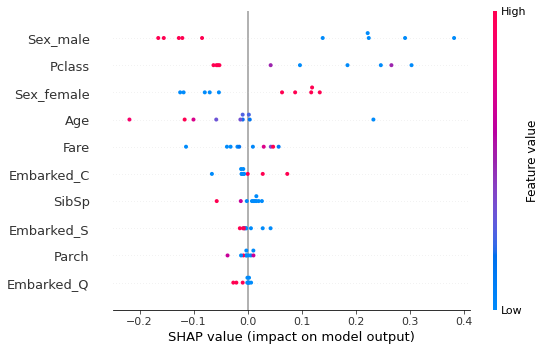

In [395]:
shap.summary_plot(shap_values, shap_test_data)

## Training The model Using SVM

In [347]:
svm_model = SVC()

In [348]:
svm_model.fit(X_train, Y_train)

SVC()

In [349]:
X_test.drop(['Survived', 'rf_preds'], axis=1, inplace=True)
svm_preds = svm_model.predict(X_test)
print(f'Accuracy of the SVM is: {accuracy_score(Y_test, svm_preds)}')

Accuracy of the SVM is: 0.6567164179104478


In [350]:
confusion_matrix(Y_test, svm_preds)

array([[150,  15],
       [ 77,  26]])

In [351]:

pd.crosstab(Y_test, svm_preds, rownames=['Actual'], colnames=['Predicted'], margins=True)

Predicted,0,1,All
Actual,,,
0,150,15,165
1,77,26,103
All,227,41,268


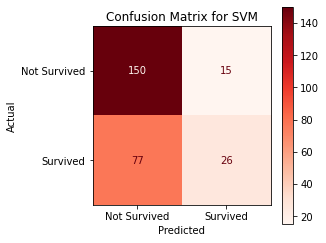

In [353]:
matrix = plot_confusion_matrix(svm_model, X_test, Y_test, cmap=plt.cm.Reds)
matrix.ax_.set_title('Confusion Matrix for SVM', color='black')
matrix.ax_.set_xticklabels(['Not Survived', 'Survived'])
matrix.ax_.set_yticklabels(['Not Survived', 'Survived'])
plt.xlabel('Predicted', color='black')
plt.ylabel('Actual', color='black')
plt.gcf().axes[0].tick_params(colors='black')
plt.gcf().axes[1].tick_params(colors='black')
plt.gcf().set_size_inches(4,4)
plt.show()

In [354]:
X_test['svm_preds'] = svm_preds
X_test['rf_preds'] = rf_preds
X_test['Survived'] = Y_test

In [355]:
print(get_statistical_parity('svm_preds', X_test))
print()
print(get_equalized_opportunity('svm_preds', X_test))
print()
print(get_equalized_odds('svm_preds', X_test))
print()
print(get_calibration('svm_preds', X_test))

('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.253')

('Equalized Opportunity [Male Group]: 0.156', 'Equalized Opportunity [Female Group]: 0.296')

('Equalized Odds [Male Group]: 0.085', 'Equalized Odds [Female Group]: 0.125')

('Calibration [Male Group]: 0.294', 'Calibration [Female Group]: 0.875')


## SHAPely values SVM

In [401]:
shap_explainer = shap.KernelExplainer(svm_model.predict, X_train)
shap_test_data = X_test[X_test.columns[:10]][:10]

Using 623 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [402]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/10 [00:00<?, ?it/s]

In [403]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)


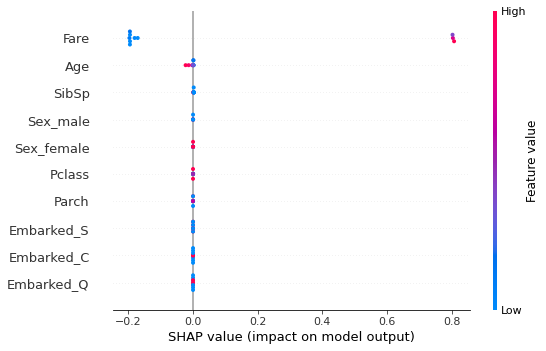

In [405]:
shap.summary_plot(shap_values, shap_test_data)


## K-Fold Cross Validations

In [300]:
kf = KFold(n_splits=10)
kf

KFold(n_splits=10, random_state=None, shuffle=False)

In [43]:
def get_score(model, X_train, X_test, y_train, y_test):
    model.fit(X_train, y_train)
    return model.score(X_test, y_test)

1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


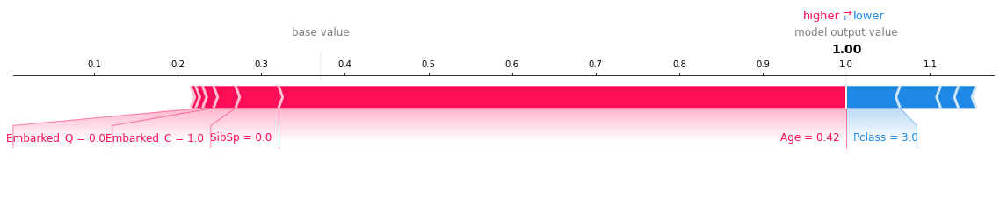

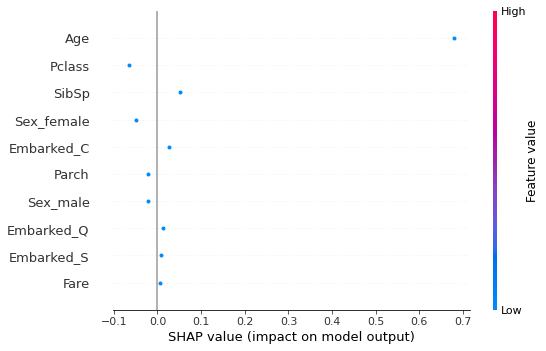

,Pclass,Age,SibSp,Parch,Fare,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
803,3,0.42,0,1,8.5167,0,1,1,0,0


In [276]:
import shap

sel_instance = X_test.iloc[[1]]
shap.initjs()
    
rf.fit(X_train, y_train)
# X_test.drop(['rf_preds', 'svm_preds', 'Survived'],1, inplace=True)
# X_test
rf_score_temp = rf.score(X_test, y_test)
rf_preds = rf.predict(sel_instance)
print(rf_preds[0])
rf_explnr = shap.KernelExplainer(rf.predict, X_test)
shap_values_rf = rf_explnr.shap_values(sel_instance)
shap_values_rf[0,:]
shap.force_plot(rf_explnr.expected_value, shap_values_rf[0,:], sel_instance, matplotlib=True)
shap.summary_plot(shap_values_rf, sel_instance)

sel_instance

In [297]:
# sel_instance = X_test.iloc[[5]]
# sel_instance
# Female baby
female_baby = pd.DataFrame(data[(data['Age']<=5) & (data['Sex_female'] == 1)]
                           .sort_values(by='Age').iloc[[0]])

# Male baby
male_baby = pd.DataFrame(data[(data['Age']<=5) & (data['Sex_male'] == 1)]
                         .sort_values(by='Age').iloc[[0]])

#female midage
female_midage = pd.DataFrame(data[(data['Age']==45) & (data['Sex_female'] == 1)]
                             .sort_values(by='Age').iloc[[0]])

#male midage
male_midage = pd.DataFrame(data[(data['Age']==45) & (data['Sex_male'] == 1)]
                           .sort_values(by='Age').iloc[[0]])

#female oldage
female_oldage = pd.DataFrame(data[(data['Age']>50) & (data['Sex_female'] == 1)]
                             .sort_values(by='Age', ascending=False).iloc[[0]])


#male oldage
male_oldage = pd.DataFrame(data[(data['Age']>50) & (data['Sex_male'] == 1)]
                           .sort_values(by='Age', ascending=False).iloc[[0]])


In [331]:
def getInsights(sel_instance):
    i=1
    rf_score = []
    svm_score = []
    actual_pred = sel_instance['Survived'].iloc[0]
    sel_instance.drop('Survived', 1, inplace=True)

    pd.set_option("mode.chained_assignment", None)
    # X_test.drop(['Survived', 'rf_preds'], axis=1, inplace=True)
    for train_index, test_index in kf.split(data):
        print('FOLD',i)
        temp_data_X = data.drop(['Survived'], axis=1)
        temp_data_y = data['Survived']

        X_train, X_test, y_train, y_test = temp_data_X.iloc[train_index, :], temp_data_X.iloc[test_index, :], \
        temp_data_y[train_index], temp_data_y[test_index]

    #     rf_score_temp = get_score(rf, X_train, X_test, y_train, y_test)
    #     svm_score_temp = get_score(SVC(), X_train, X_test, y_train, y_test)

    #     sel_instance = X_test.iloc[[15]]
        shap.initjs()

        rf.fit(X_train, y_train)
        # X_test.drop(['rf_preds', 'svm_preds', 'Survived'],1, inplace=True)
        # X_test
        rf_score_temp = rf.score(X_test, y_test)
        rf_preds = rf.predict(X_test)
        rf_explnr = shap.KernelExplainer(rf.predict, X_test)
        shap_values_rf = rf_explnr.shap_values(sel_instance)
    #     shap.force_plot(rf_explnr.expected_value, shap_values_rf[0,:], sel_instance, matplotlib=True)
    #     shap.summary_plot(shap_values_rf, sel_instance)


        svm_model.fit(X_train, y_train)
        svm_score_temp = svm_model.score(X_test, y_test)
        svm_preds = svm_model.predict(X_test)
        svm_explnr = shap.KernelExplainer(svm_model.predict, X_test)
        shap_values_svm = svm_explnr.shap_values(sel_instance)
    #     shap.force_plot(svm_explnr.expected_value, shap_values_svm[0,:], sel_instance, matplotlib=True)
    #     shap.summary_plot(shap_values_rf, sel_instance)

        X_test.loc[:,'Survived'] = y_test
        X_test.loc[:,'rf_preds'] = rf_preds
        X_test.loc[:,'svm_preds'] = svm_preds
#         X_test['Survived'] = y_test
#         X_test['rf_preds'] = rf_preds
#         X_test['svm_preds'] = svm_preds
        rf_score.append([i,round(rf_score_temp, 3)])
        svm_score.append([i,round(svm_score_temp, 3)])
        
        
        print(sel_instance)

        print('*****Accuracy Random Forest: ',round(rf_score_temp, 3))
        print(get_statistical_parity('rf_preds', X_test))
        print(get_equalized_opportunity('rf_preds', X_test))
        print(get_calibration('rf_preds', X_test))
        print(f'Actual predictor: {actual_pred}')
        shap.force_plot(rf_explnr.expected_value, shap_values_rf[0,:], sel_instance, matplotlib=True)
        print()

        print('*****Accuracy SVM: ',round(svm_score_temp, 3))
        print(get_statistical_parity('svm_preds', X_test))
        print(get_equalized_opportunity('svm_preds', X_test))
        print(get_equalized_odds('svm_preds', X_test))
        print(get_calibration('svm_preds', X_test))
        print(f'Actual predictor: {actual_pred}')
        print(shap_values_svm[0,:])
        shap.force_plot(svm_explnr.expected_value, shap_values_svm[0,:], sel_instance, matplotlib=True)
        print()


    #     print(f'RF\t-Fold{i}\t:{rf_score_temp}')
    #     print(f'SVM\t-Fold{i}\t:{svm_score_temp}')
        i+=1    

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.756
('Statistical Parity [Male Group]: 0.212', 'Statistical Parity [Female Group]: 0.789')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.867')
('Calibration [Male Group]: 0.273', 'Calibration [Female Group]: 0.867')
Actual predictor: 1


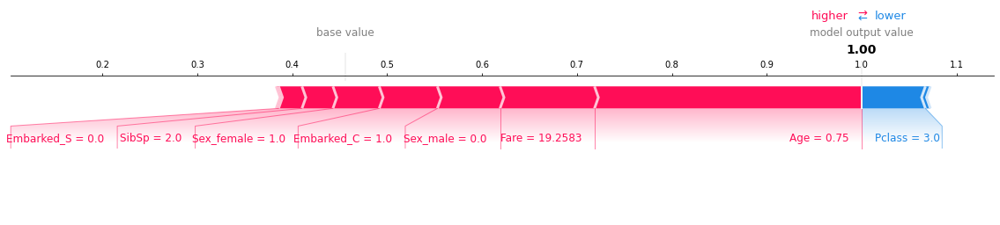


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 1
[-0.00078924  0.03925044  0.00626102  0.00034832 -0.19495591  0.002306
  0.002306    0.00041446  0.          0.00041446]


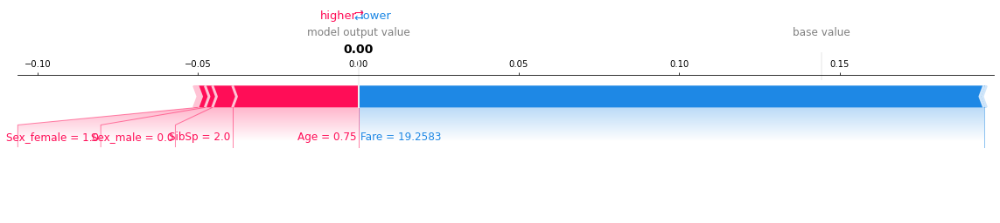


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.077', 'Statistical Parity [Female Group]: 0.75')
('Equalized Opportunity [Male Group]: 0.0', 'Equalized Opportunity [Female Group]: 0.929')
('Calibration [Male Group]: 0.0', 'Calibration [Female Group]: 0.722')
Actual predictor: 1


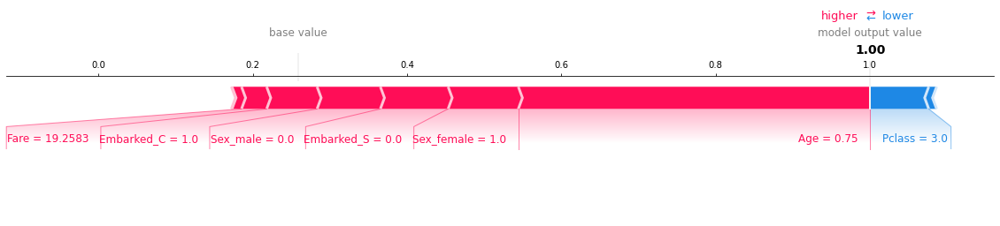


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 1
[-2.04209024e-03  3.49563046e-02 -2.04209024e-03 -1.02550383e-04
 -2.03125557e-01  1.36882468e-03  1.36882468e-03  3.52238274e-04
  0.00000000e+00  7.26770109e-04]


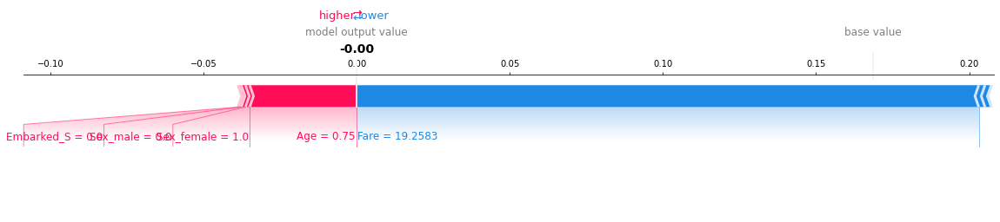


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.053', 'Statistical Parity [Female Group]: 0.719')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.818')
('Calibration [Male Group]: 0.667', 'Calibration [Female Group]: 0.783')
Actual predictor: 1


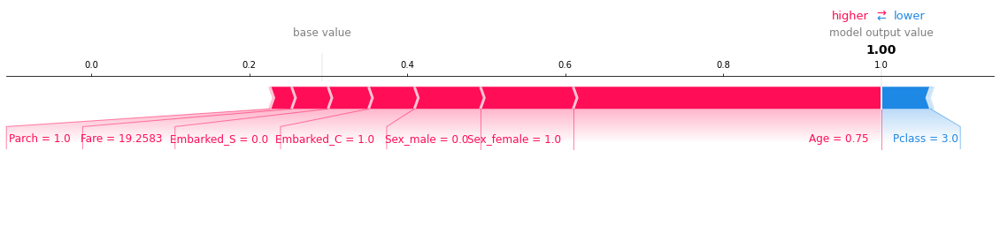


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 1
[-2.65293383e-03  2.95166756e-03 -3.38862137e-03 -8.47155342e-05
 -1.39049403e-01  3.37970394e-03  3.37970394e-03  3.16568575e-04
  0.00000000e+00  3.16568575e-04]


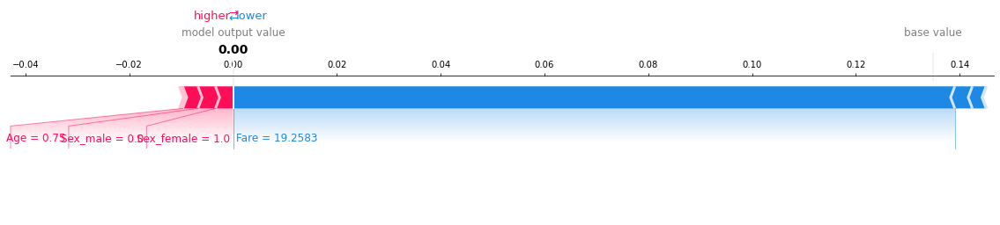


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.16', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.857')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.938')
Actual predictor: 1


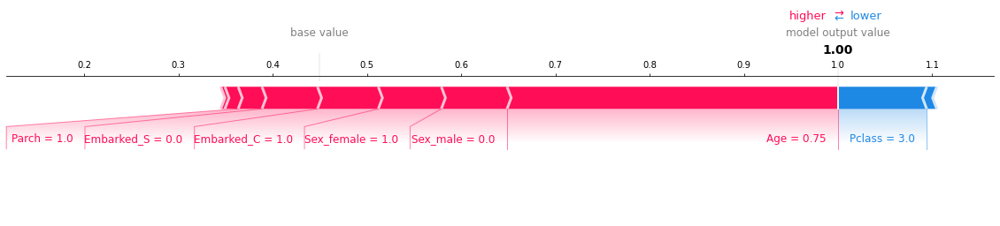


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 1
[ 0.          0.          0.          0.         -0.26966292  0.
  0.          0.          0.          0.        ]


divide by zero encountered in double_scalars


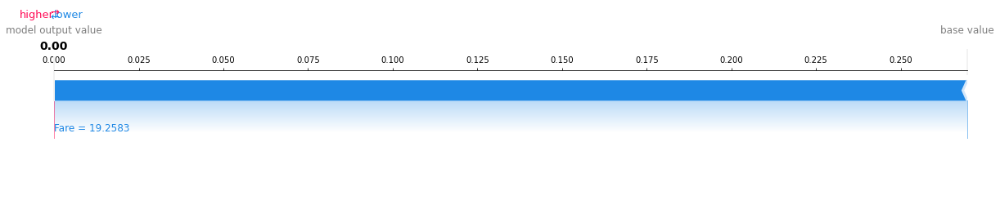


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.865
('Statistical Parity [Male Group]: 0.196', 'Statistical Parity [Female Group]: 0.763')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 1.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.931')
Actual predictor: 1


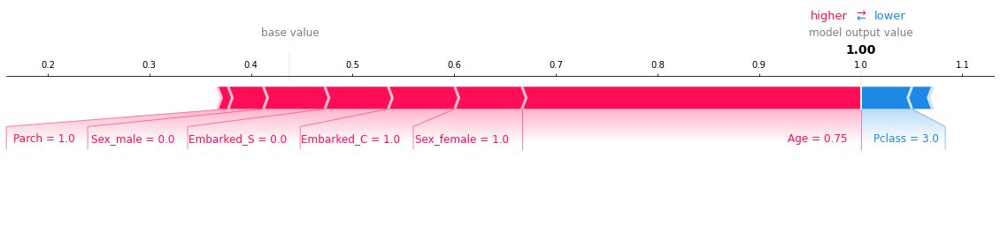


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 1
[-3.22364901e-03  8.37346174e-03  5.21669342e-04  1.33761370e-04
 -1.79293740e-01  1.72552167e-03  1.72552167e-03  7.49063670e-04
  0.00000000e+00  7.49063670e-04]


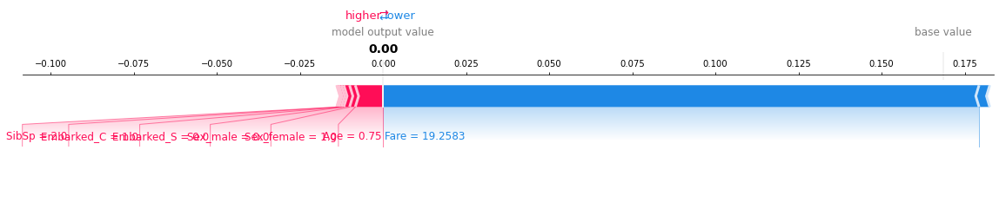


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.786')
('Equalized Opportunity [Male Group]: 0.364', 'Equalized Opportunity [Female Group]: 0.857')
('Calibration [Male Group]: 0.8', 'Calibration [Female Group]: 0.818')
Actual predictor: 1


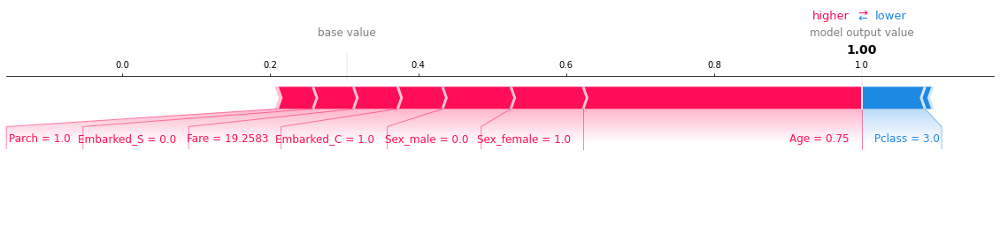


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 1
[-0.00421794  0.01148564 -0.00536829 -0.00230515 -0.15304084  0.00204209
  0.00204209  0.00156055  0.          0.00173444]


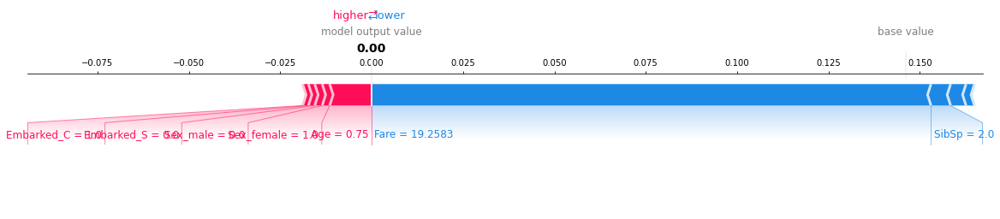


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.14', 'Statistical Parity [Female Group]: 0.781')
('Equalized Opportunity [Male Group]: 0.267', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.88')
Actual predictor: 1


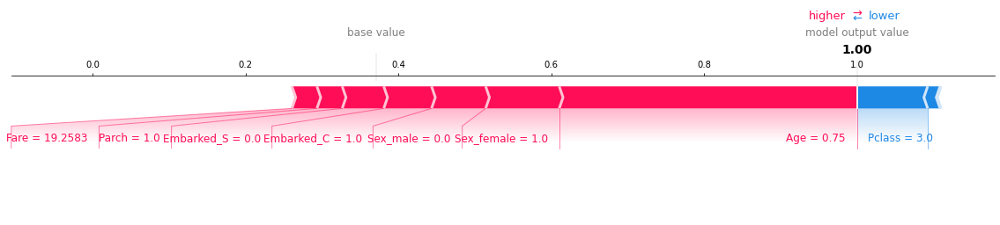


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 1
[-1.31086142e-03  3.55805243e-03 -1.49812734e-03 -3.74531835e-04
 -1.36329588e-01  4.54788657e-04  4.54788657e-04  1.07009096e-04
  0.00000000e+00  1.07009096e-04]


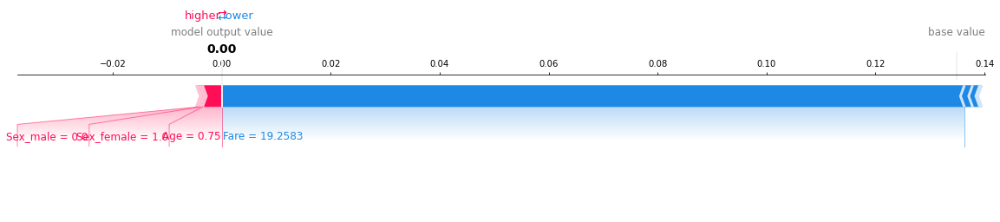


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.125', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.842')
Actual predictor: 1


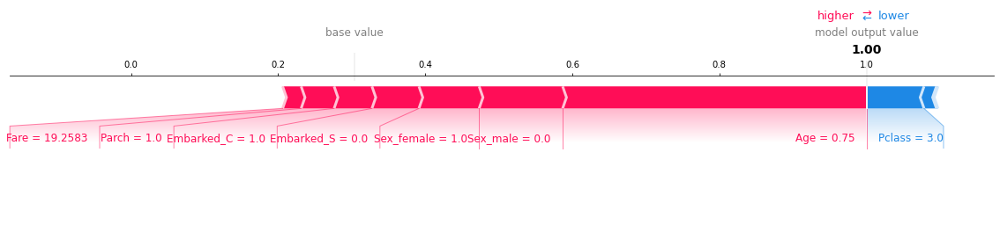


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 1
[-0.00434724  0.05707598 -0.00779829 -0.00034778 -0.25086945  0.00172552
  0.00172552  0.00025415  0.          0.0003344 ]


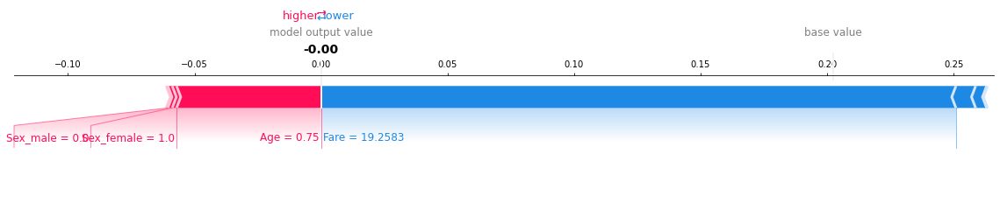


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.18', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.364', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


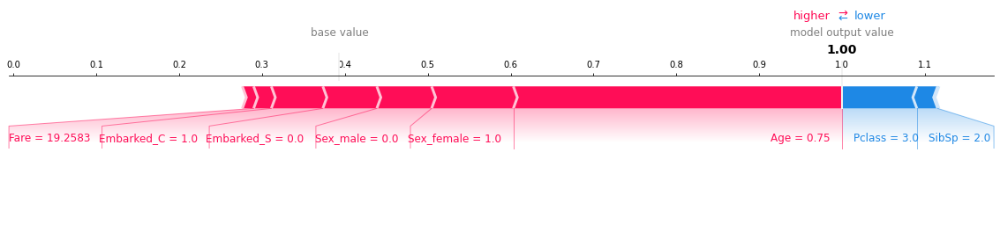


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 1
[-4.45871232e-04  7.44604958e-04 -4.45871232e-04 -2.58605315e-04
 -1.80154271e-01  3.70073123e-04  3.70073123e-04  2.22935616e-05
  0.00000000e+00  2.22935616e-05]


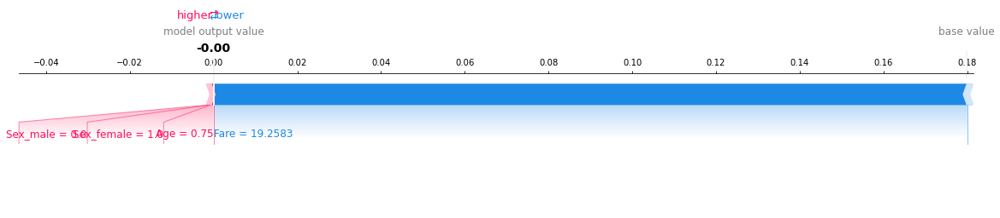


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
469       3  0.75      2      1  19.2583           1         0           1   

     Embarked_Q  Embarked_S  
469           0           0  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.169', 'Statistical Parity [Female Group]: 0.8')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.7', 'Calibration [Female Group]: 0.792')
Actual predictor: 1


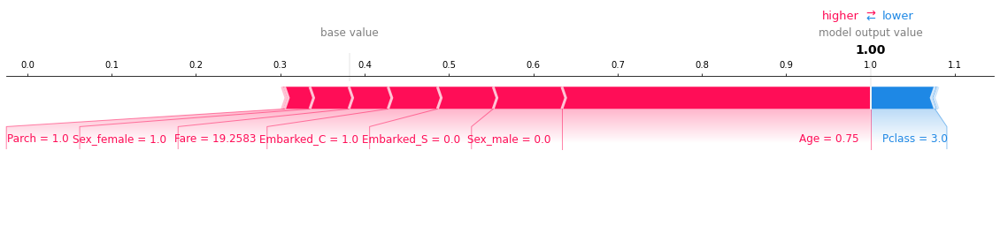


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 1
[-0.00257268  0.01626092 -0.00265293 -0.00032549 -0.14890762  0.00122615
  0.00122615  0.00043695  0.          0.00047708]


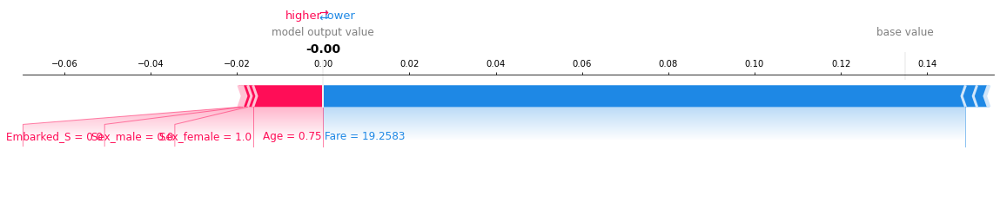

In [332]:
getInsights(female_baby.copy())

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.789
('Statistical Parity [Male Group]: 0.173', 'Statistical Parity [Female Group]: 0.816')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.9')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.871')
Actual predictor: 1


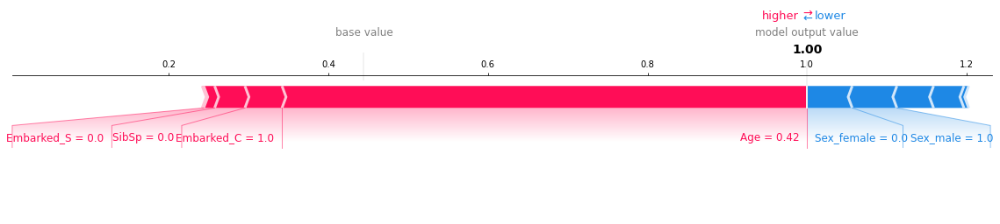


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


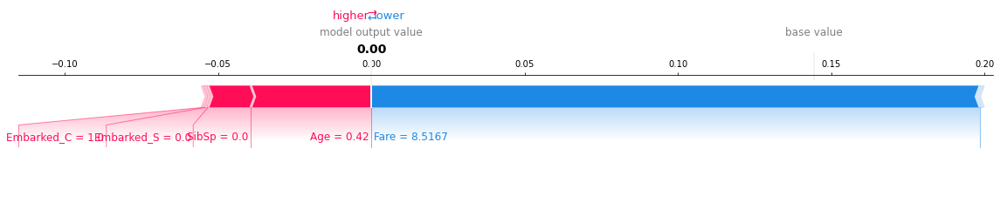


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.077', 'Statistical Parity [Female Group]: 0.75')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.929')
('Calibration [Male Group]: 0.2', 'Calibration [Female Group]: 0.722')
Actual predictor: 1


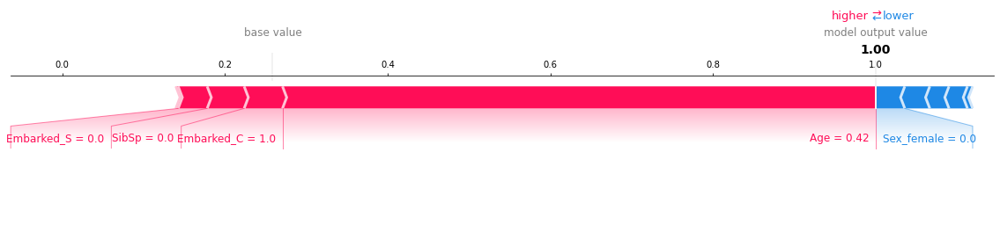


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


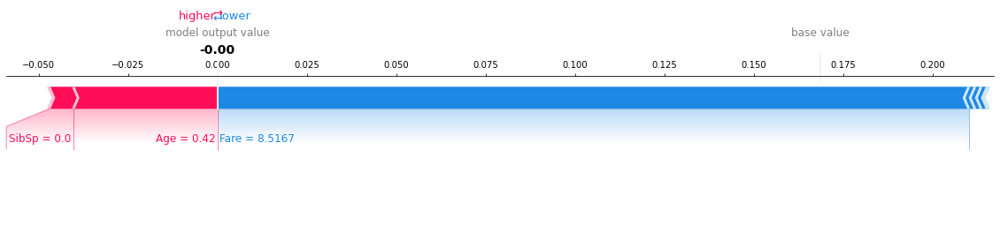


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.035', 'Statistical Parity [Female Group]: 0.75')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.818')
('Calibration [Male Group]: 1.0', 'Calibration [Female Group]: 0.75')
Actual predictor: 1


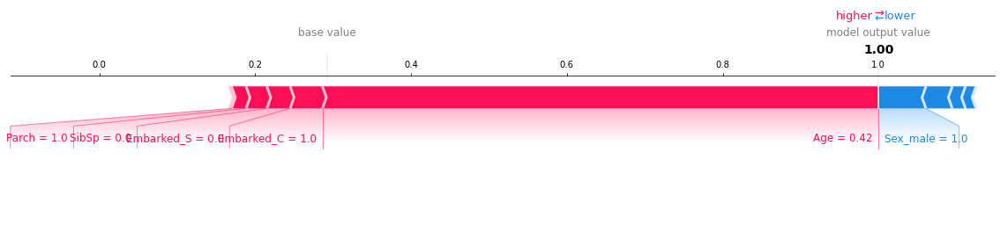


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


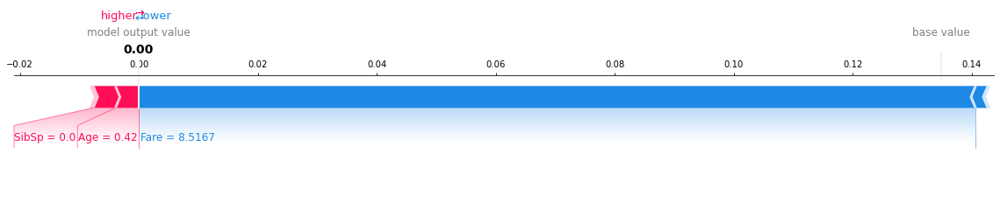


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.82
('Statistical Parity [Male Group]: 0.16', 'Statistical Parity [Female Group]: 0.846')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.886')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.939')
Actual predictor: 1


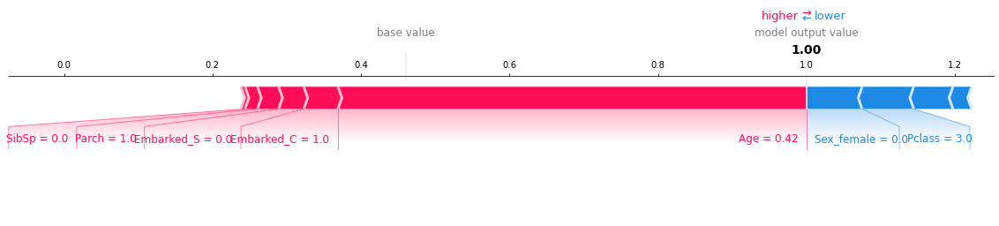


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 1


divide by zero encountered in double_scalars


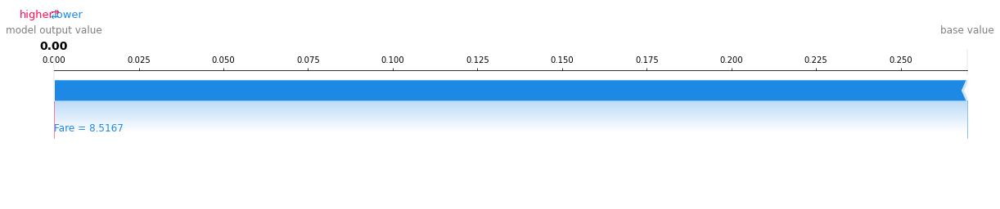


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.157', 'Statistical Parity [Female Group]: 0.737')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.963')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.929')
Actual predictor: 1


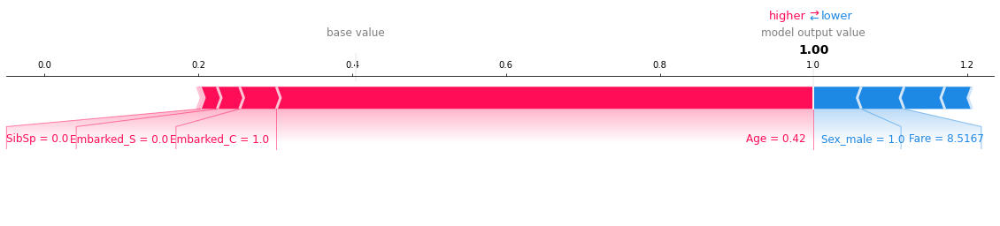


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


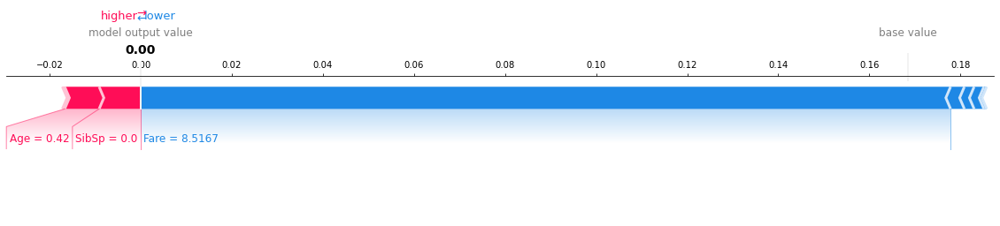


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.843
('Statistical Parity [Male Group]: 0.066', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.952')
('Calibration [Male Group]: 0.75', 'Calibration [Female Group]: 0.833')
Actual predictor: 1


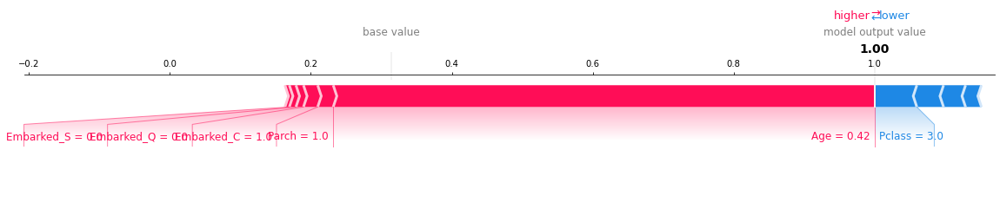


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


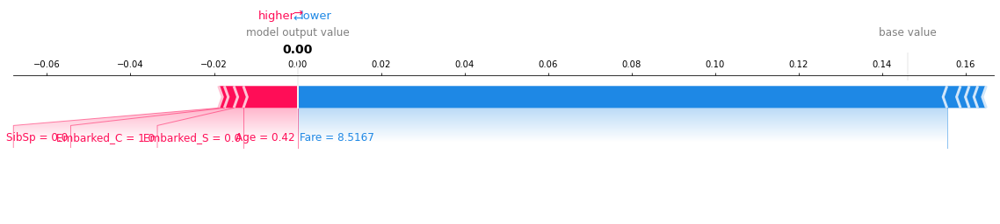


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.123', 'Statistical Parity [Female Group]: 0.781')
('Equalized Opportunity [Male Group]: 0.267', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.571', 'Calibration [Female Group]: 0.88')
Actual predictor: 1


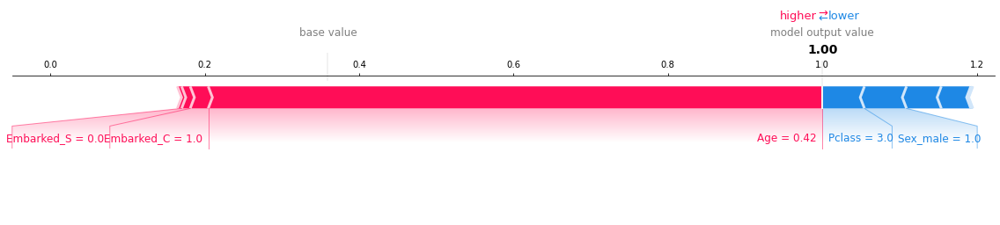


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


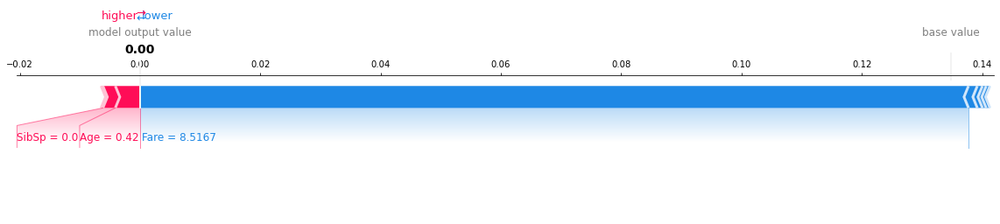


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.125', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.842')
Actual predictor: 1


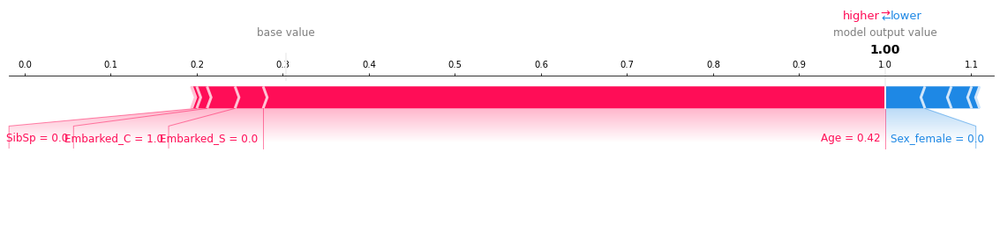


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


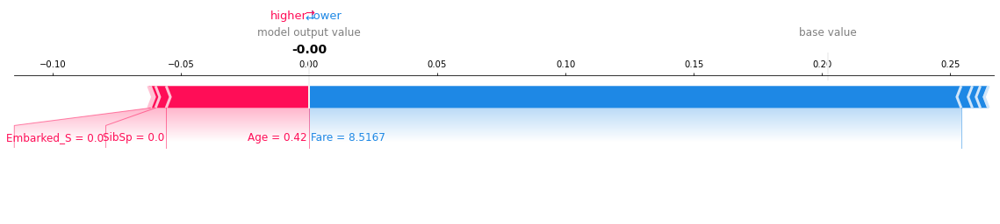


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.164', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.4', 'Calibration [Female Group]: 0.913')
Actual predictor: 1


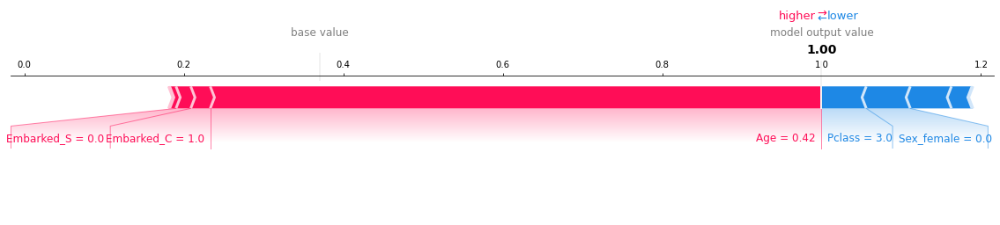


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 1


divide by zero encountered in double_scalars


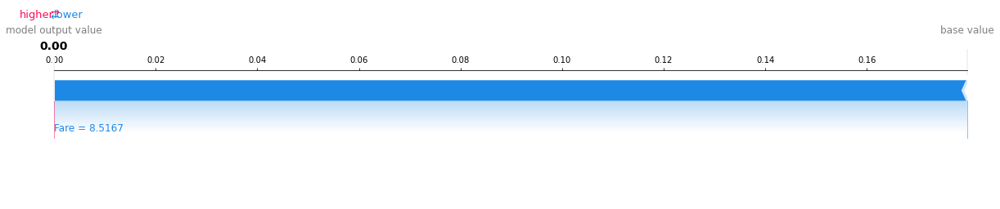


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
803       3  0.42      0      1  8.5167           0         1           1   

     Embarked_Q  Embarked_S  
803           0           0  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.169', 'Statistical Parity [Female Group]: 0.8')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.7', 'Calibration [Female Group]: 0.792')
Actual predictor: 1


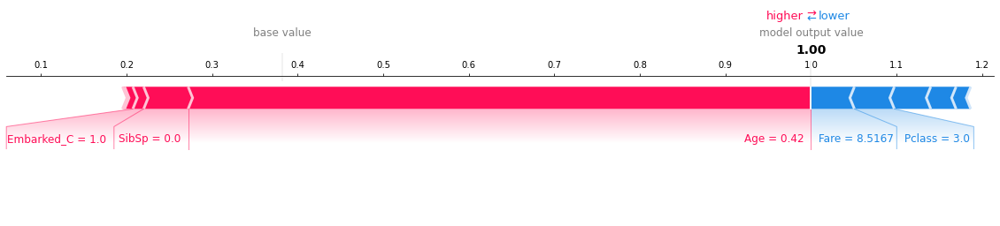


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


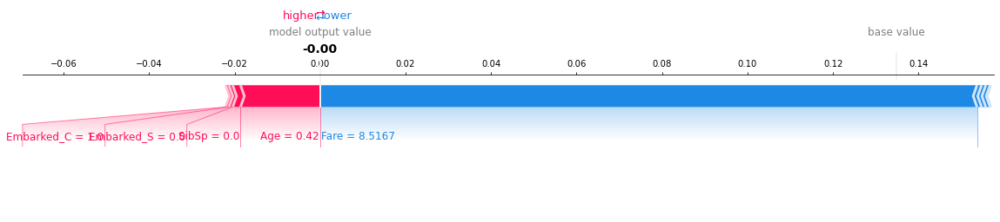

In [303]:
getInsights(male_baby.copy())

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.744
('Statistical Parity [Male Group]: 0.212', 'Statistical Parity [Female Group]: 0.816')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.867')
('Calibration [Male Group]: 0.273', 'Calibration [Female Group]: 0.839')
Actual predictor: 0


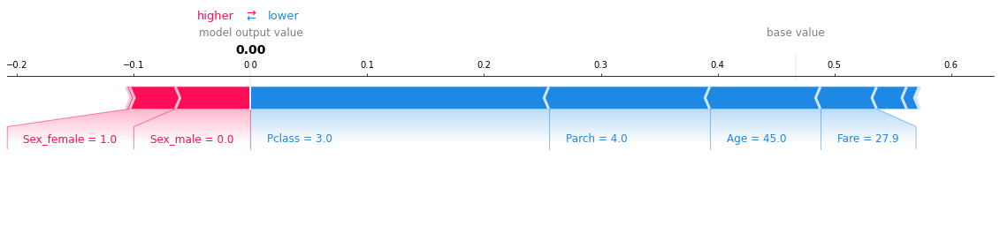


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


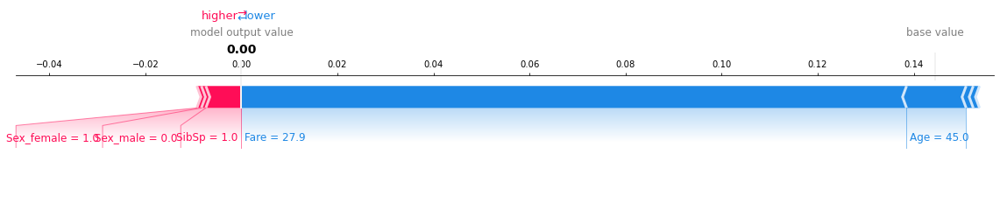


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.82
('Statistical Parity [Male Group]: 0.092', 'Statistical Parity [Female Group]: 0.75')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.929')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 0.722')
Actual predictor: 0


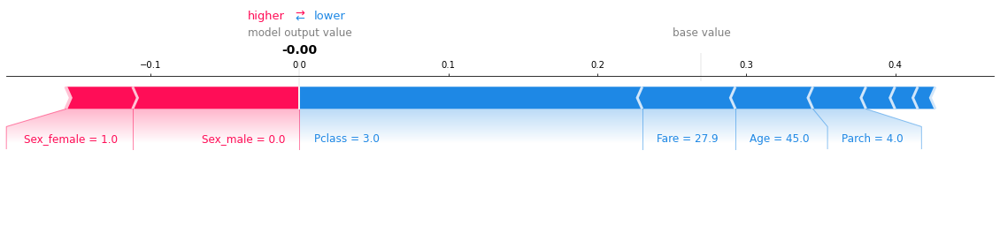


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


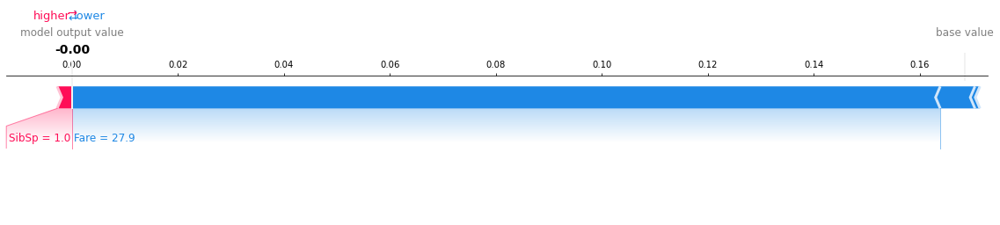


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.053', 'Statistical Parity [Female Group]: 0.719')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.818')
('Calibration [Male Group]: 0.667', 'Calibration [Female Group]: 0.783')
Actual predictor: 0


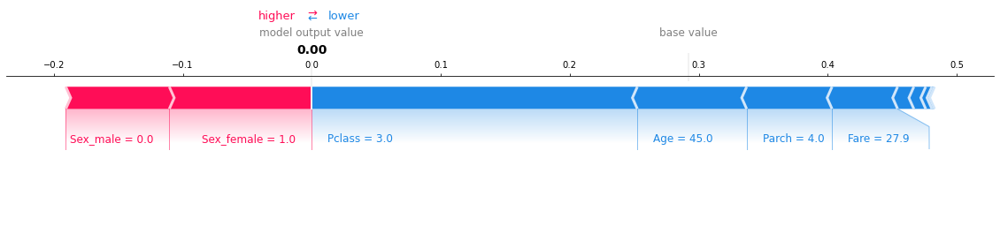


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


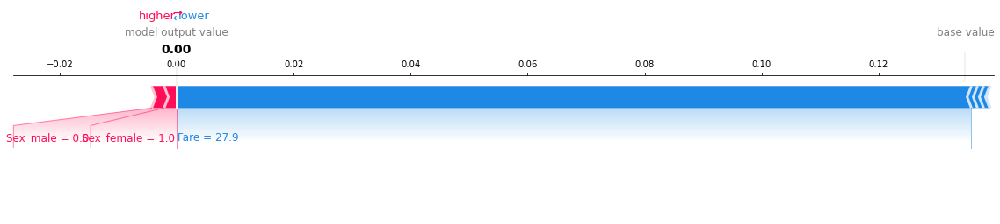


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.82
('Statistical Parity [Male Group]: 0.14', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.857')
('Calibration [Male Group]: 0.571', 'Calibration [Female Group]: 0.938')
Actual predictor: 0


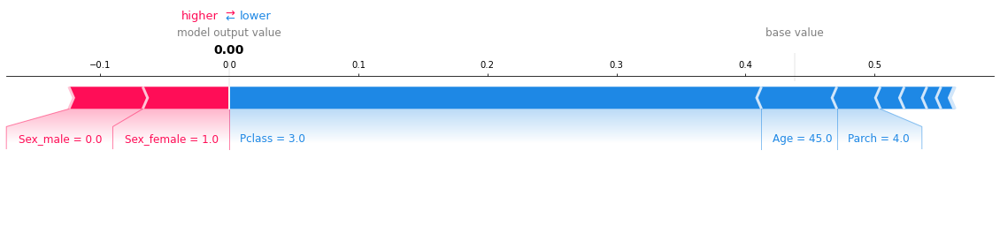


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 0


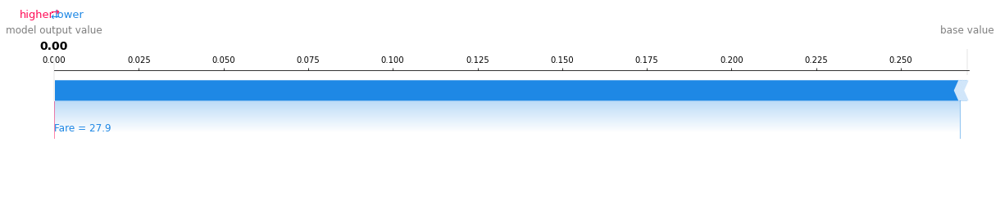


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.157', 'Statistical Parity [Female Group]: 0.789')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 1.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.9')
Actual predictor: 0


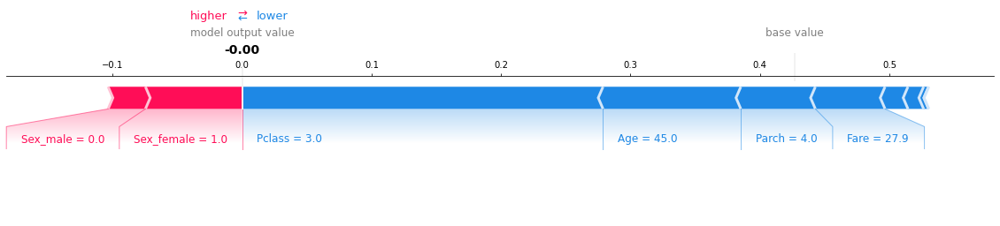


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


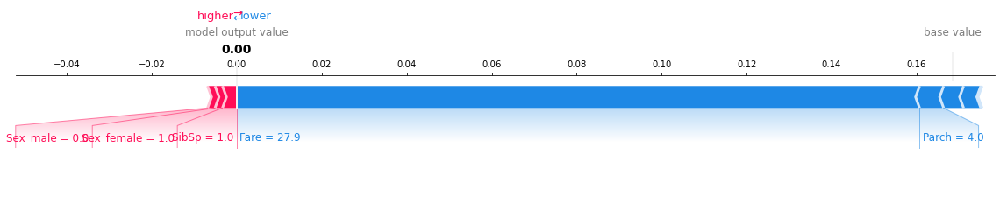


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.865
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.364', 'Equalized Opportunity [Female Group]: 0.952')
('Calibration [Male Group]: 0.8', 'Calibration [Female Group]: 0.87')
Actual predictor: 0


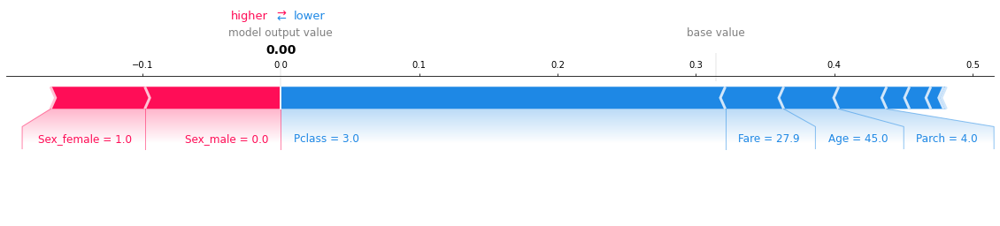


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


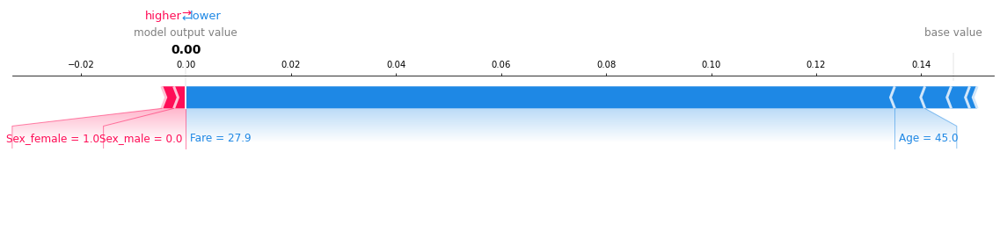


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.158', 'Statistical Parity [Female Group]: 0.812')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.556', 'Calibration [Female Group]: 0.846')
Actual predictor: 0


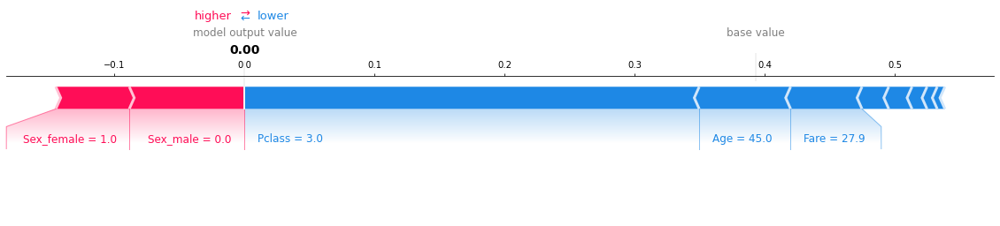


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


divide by zero encountered in double_scalars


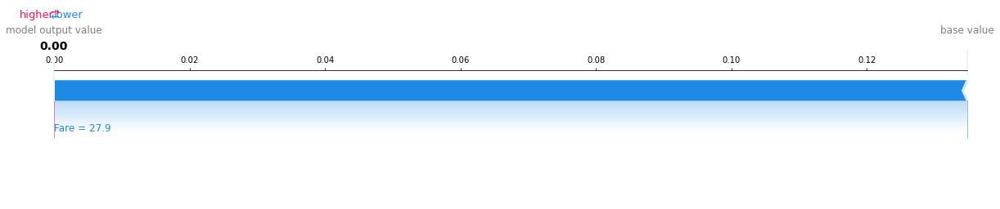


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.109', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.571', 'Calibration [Female Group]: 0.842')
Actual predictor: 0


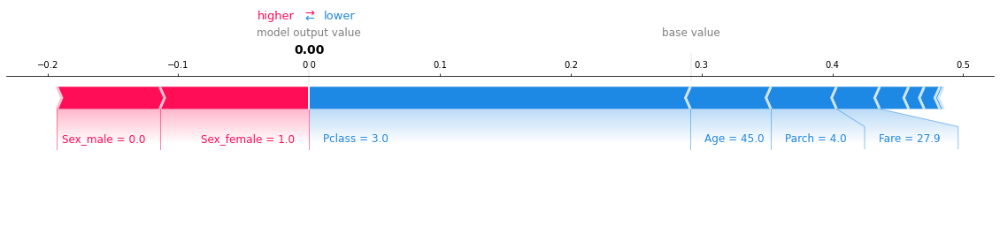


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


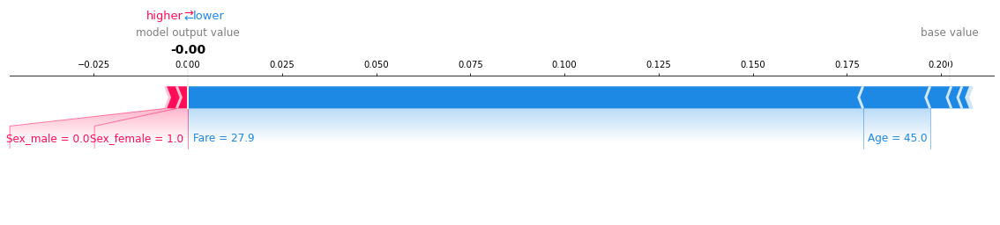


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.82
('Statistical Parity [Male Group]: 0.197', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


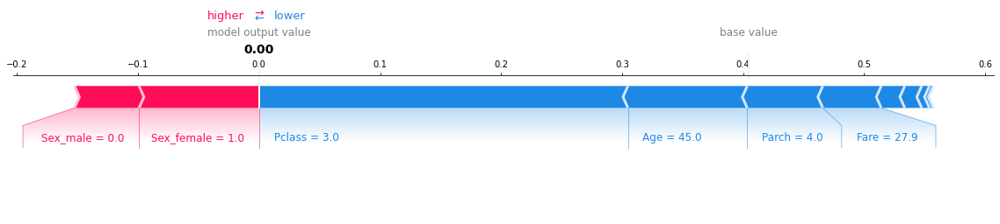


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 0


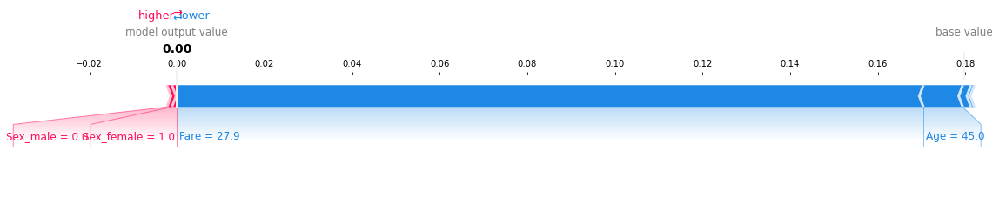


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
167       3  45.0      1      4  27.9           1         0           0   

     Embarked_Q  Embarked_S  
167           0           1  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.153', 'Statistical Parity [Female Group]: 0.767')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.778', 'Calibration [Female Group]: 0.826')
Actual predictor: 0


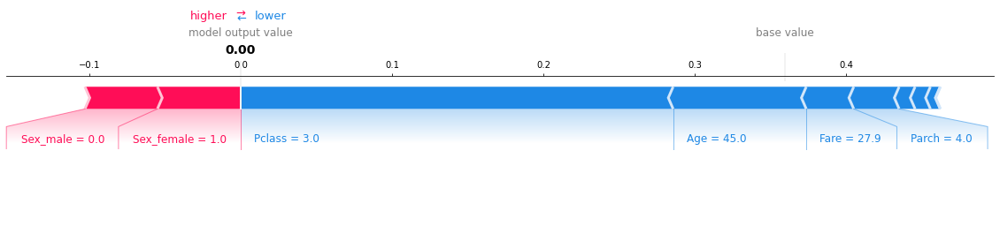


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


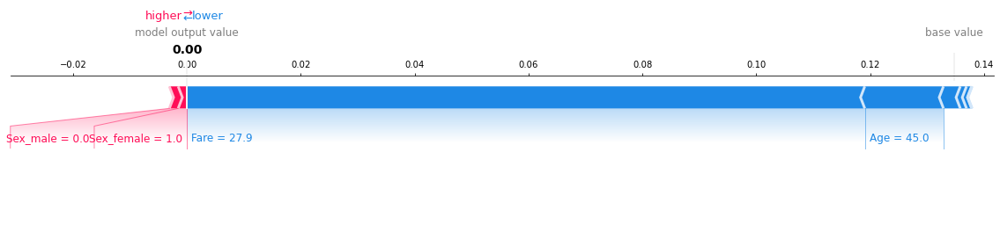

In [304]:
getInsights(female_midage.copy())

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.778
('Statistical Parity [Male Group]: 0.192', 'Statistical Parity [Female Group]: 0.816')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.9')
('Calibration [Male Group]: 0.3', 'Calibration [Female Group]: 0.871')
Actual predictor: 0


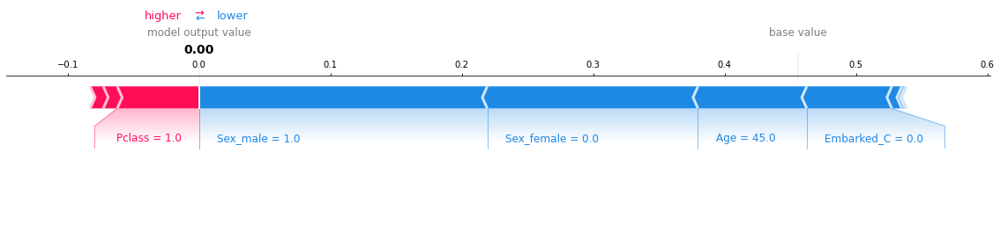


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


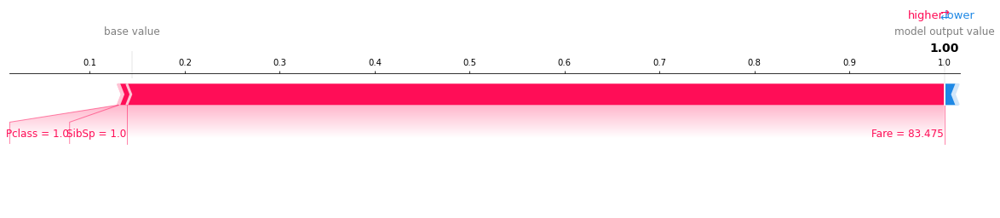


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.092', 'Statistical Parity [Female Group]: 0.792')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.929')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 0.684')
Actual predictor: 0


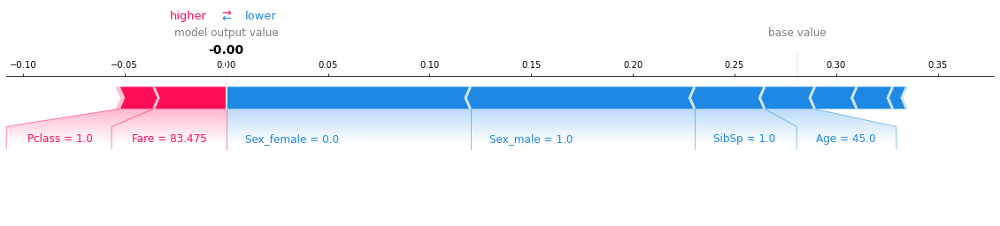


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


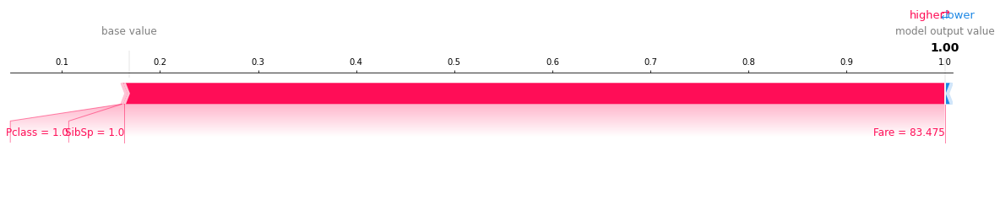


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.035', 'Statistical Parity [Female Group]: 0.719')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.818')
('Calibration [Male Group]: 1.0', 'Calibration [Female Group]: 0.783')
Actual predictor: 0


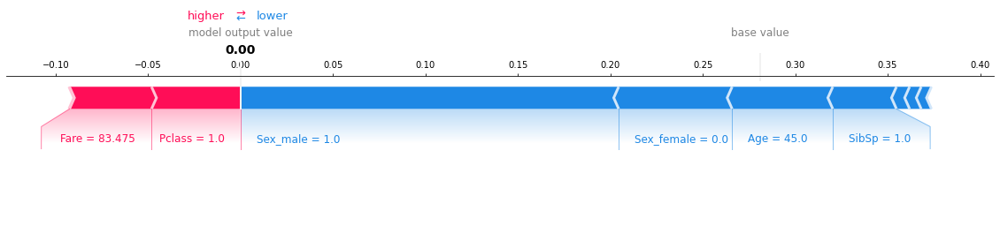


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


divide by zero encountered in double_scalars


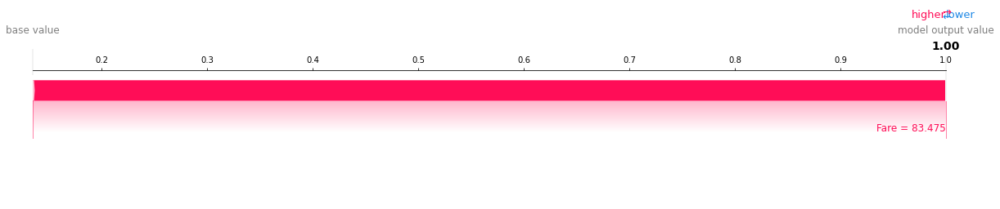


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.18', 'Statistical Parity [Female Group]: 0.846')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.886')
('Calibration [Male Group]: 0.444', 'Calibration [Female Group]: 0.939')
Actual predictor: 0


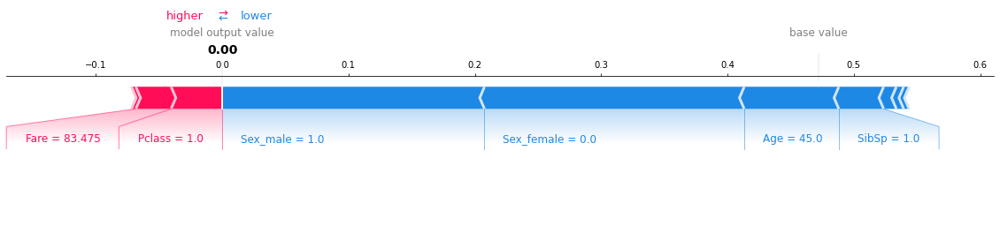


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 0


divide by zero encountered in double_scalars


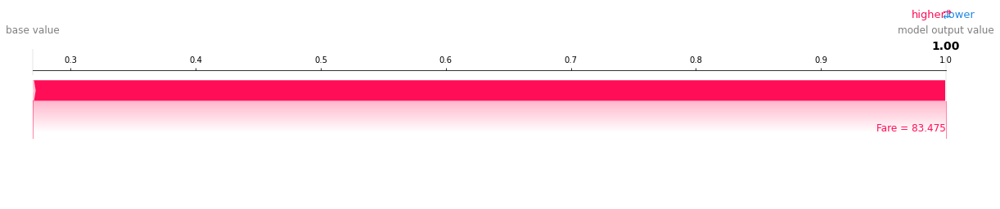


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.876
('Statistical Parity [Male Group]: 0.157', 'Statistical Parity [Female Group]: 0.737')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 1.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.964')
Actual predictor: 0


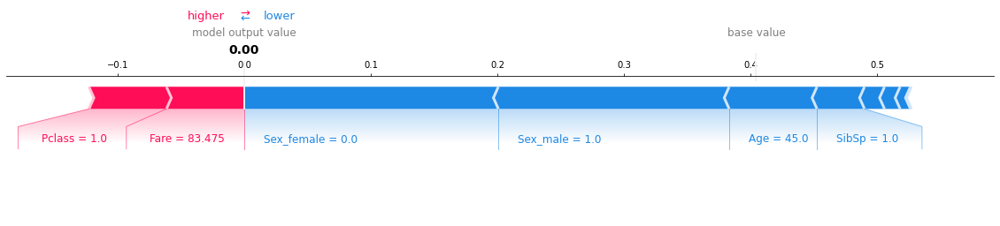


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


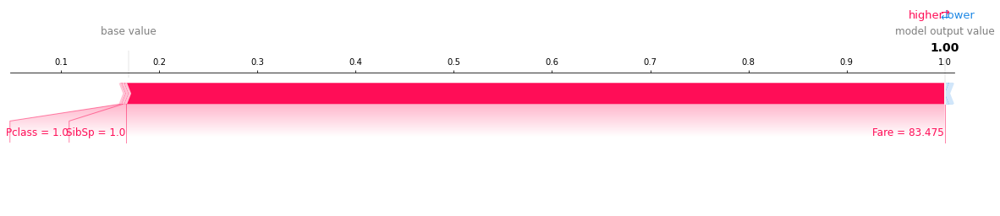


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.066', 'Statistical Parity [Female Group]: 0.893')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.952')
('Calibration [Male Group]: 0.75', 'Calibration [Female Group]: 0.8')
Actual predictor: 0


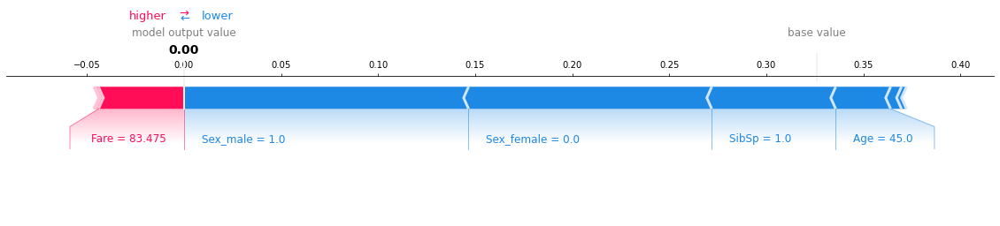


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


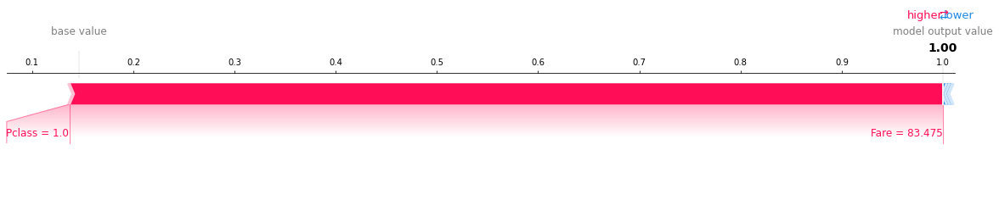


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.123', 'Statistical Parity [Female Group]: 0.812')
('Equalized Opportunity [Male Group]: 0.267', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.571', 'Calibration [Female Group]: 0.846')
Actual predictor: 0


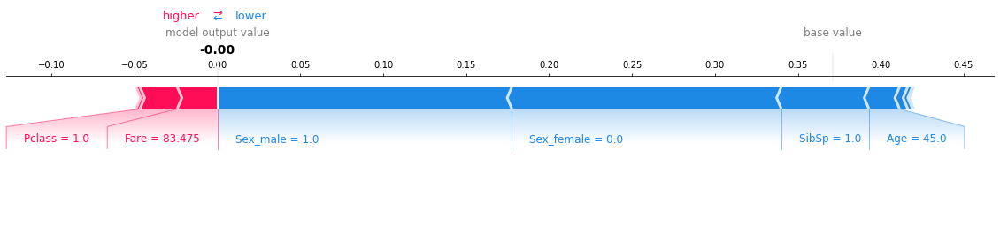


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


divide by zero encountered in double_scalars


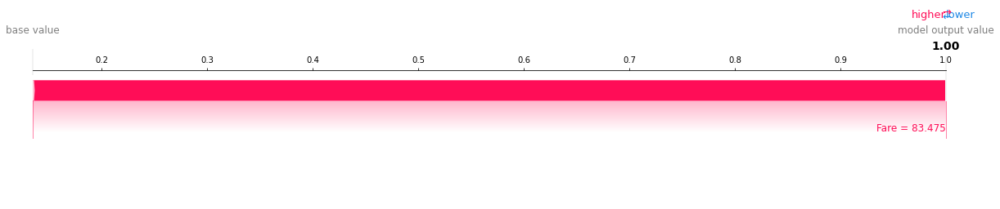


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.125', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.842')
Actual predictor: 0


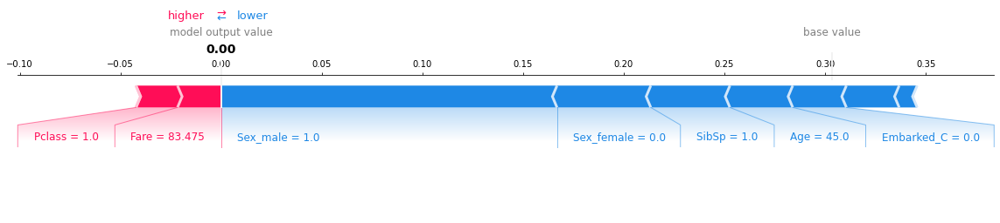


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 0


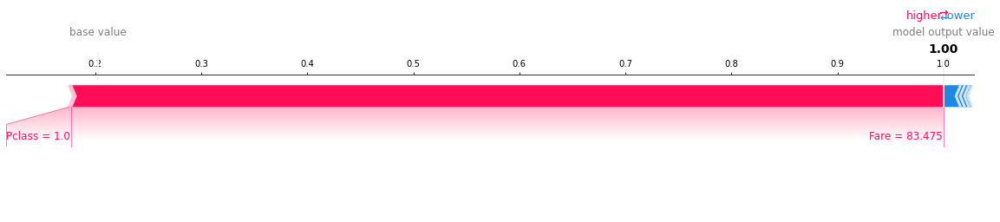


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.197', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.913')
Actual predictor: 0


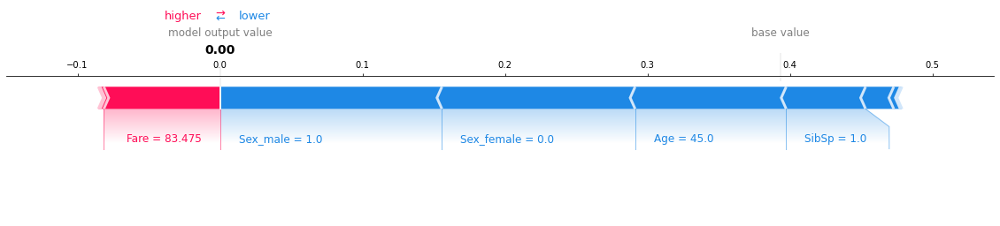


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 0


divide by zero encountered in double_scalars


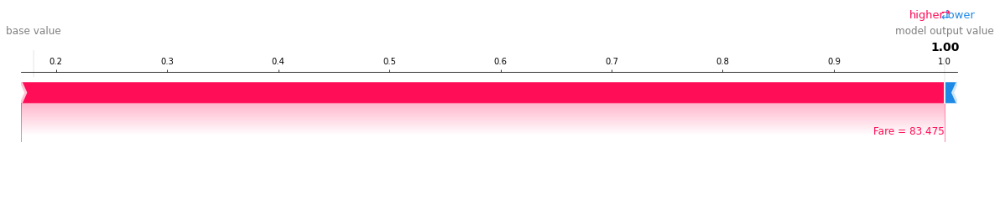


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


    Pclass   Age  SibSp  Parch    Fare  Sex_female  Sex_male  Embarked_C  \
62       1  45.0      1      0  83.475           0         1           0   

    Embarked_Q  Embarked_S  
62           0           1  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.136', 'Statistical Parity [Female Group]: 0.8')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.875', 'Calibration [Female Group]: 0.792')
Actual predictor: 0


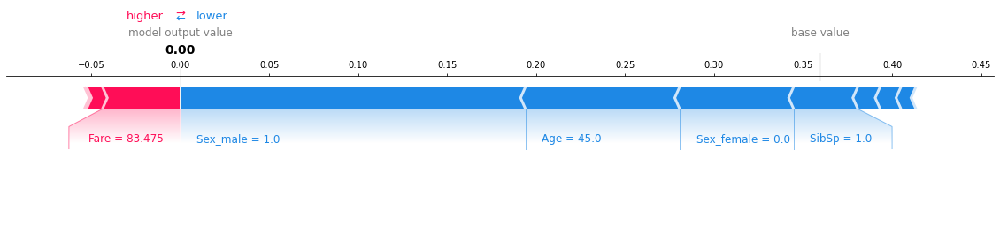


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 0


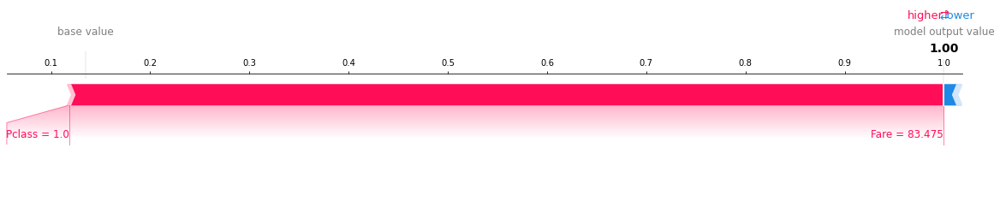

In [305]:
getInsights(male_midage.copy())

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.733
('Statistical Parity [Male Group]: 0.231', 'Statistical Parity [Female Group]: 0.763')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.833')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.862')
Actual predictor: 1


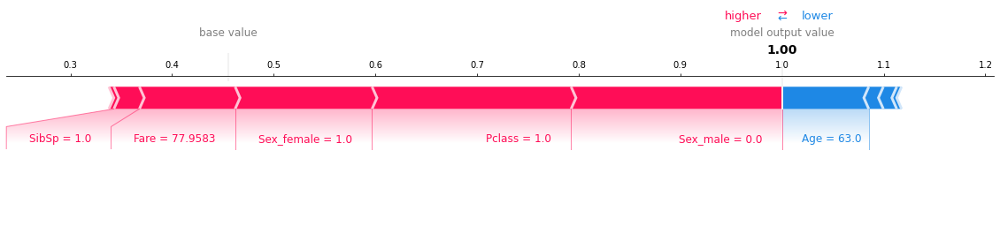


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


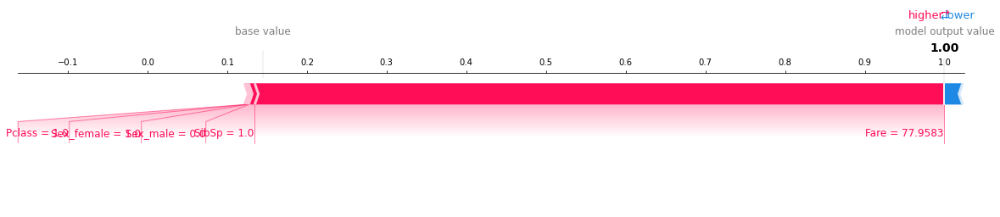


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.077', 'Statistical Parity [Female Group]: 0.75')
('Equalized Opportunity [Male Group]: 0.0', 'Equalized Opportunity [Female Group]: 0.929')
('Calibration [Male Group]: 0.0', 'Calibration [Female Group]: 0.722')
Actual predictor: 1


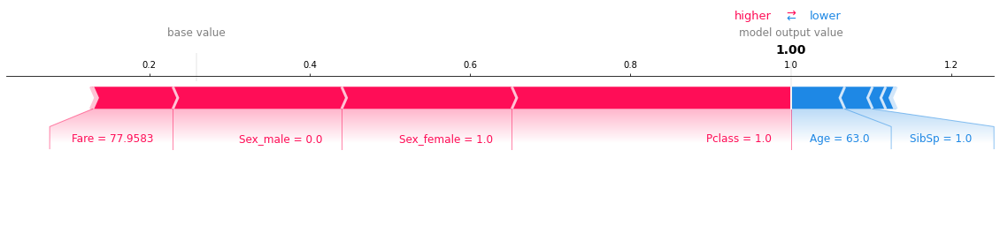


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


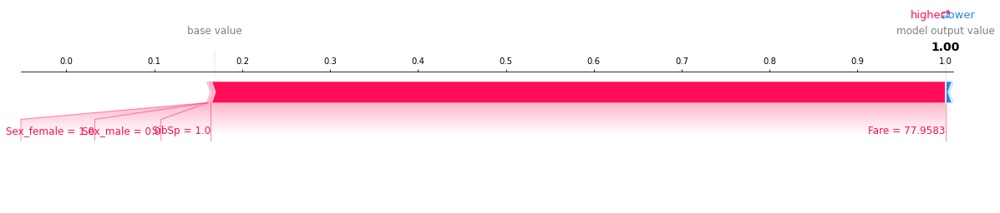


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.764
('Statistical Parity [Male Group]: 0.053', 'Statistical Parity [Female Group]: 0.812')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.864')
('Calibration [Male Group]: 0.667', 'Calibration [Female Group]: 0.731')
Actual predictor: 1


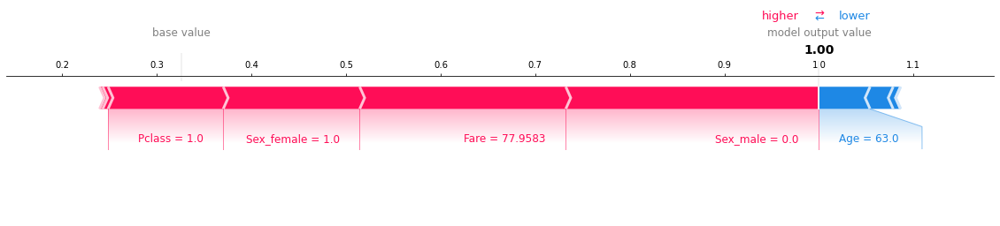


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


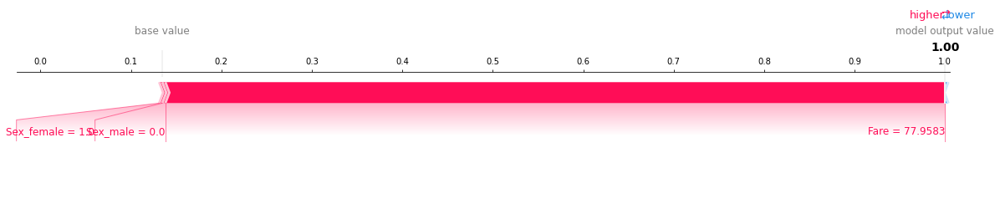


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.809
('Statistical Parity [Male Group]: 0.18', 'Statistical Parity [Female Group]: 0.846')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.886')
('Calibration [Male Group]: 0.444', 'Calibration [Female Group]: 0.939')
Actual predictor: 1


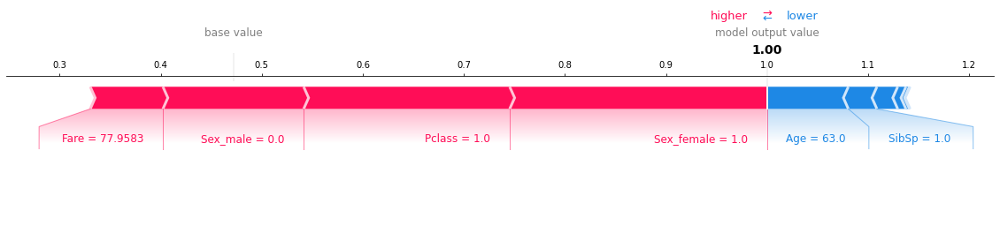


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 1


divide by zero encountered in double_scalars


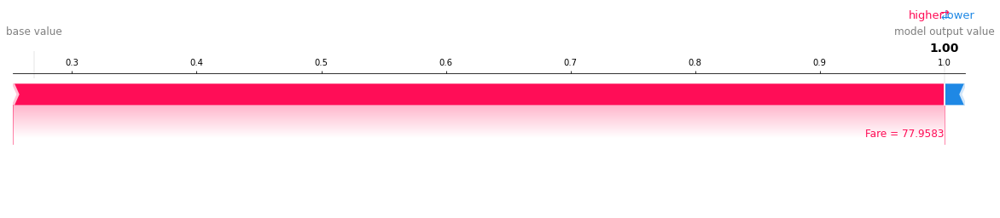


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.865
('Statistical Parity [Male Group]: 0.196', 'Statistical Parity [Female Group]: 0.763')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 1.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.931')
Actual predictor: 1


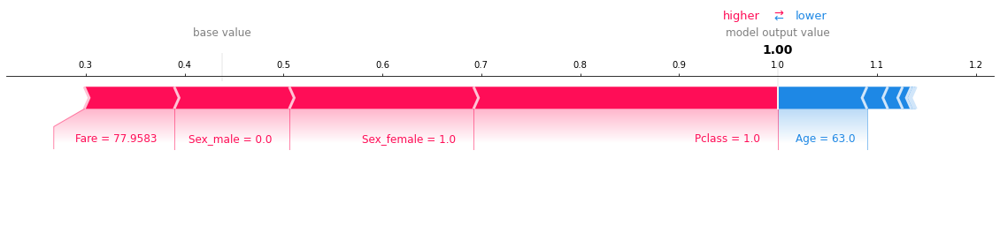


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


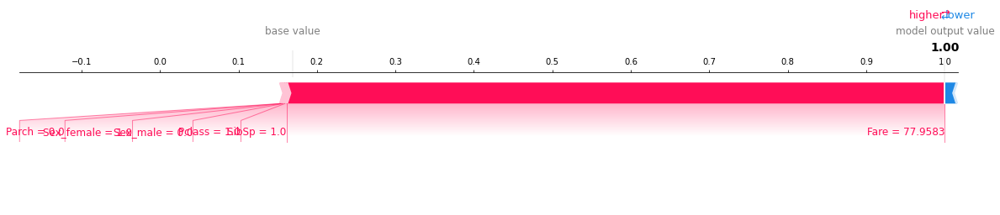


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.952')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.833')
Actual predictor: 1


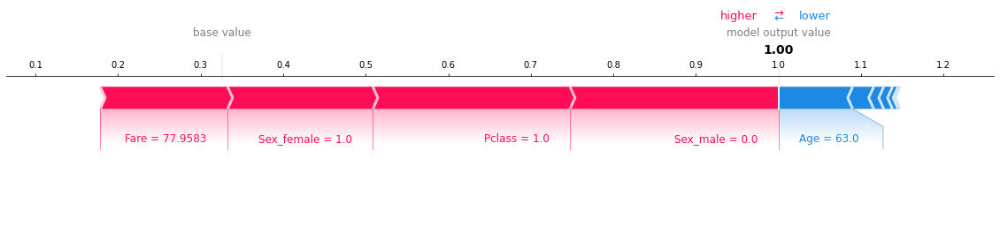


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


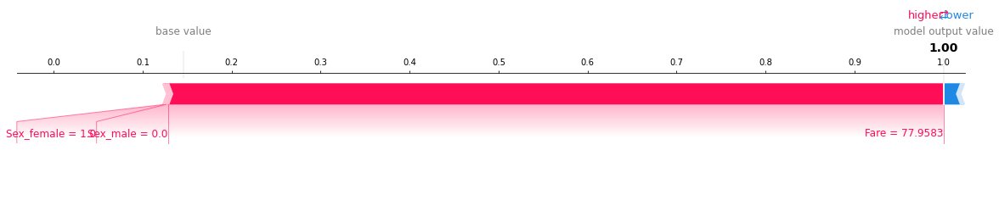


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.14', 'Statistical Parity [Female Group]: 0.781')
('Equalized Opportunity [Male Group]: 0.267', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.88')
Actual predictor: 1


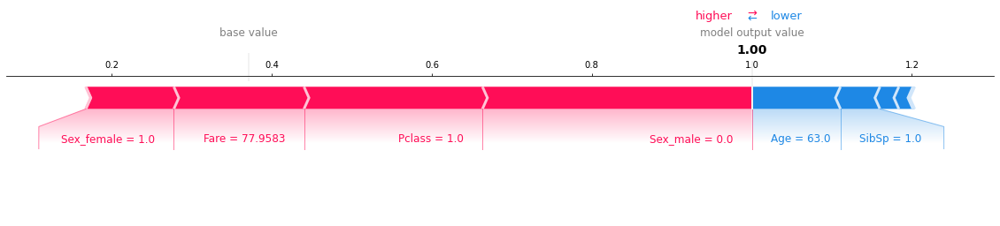


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


divide by zero encountered in double_scalars


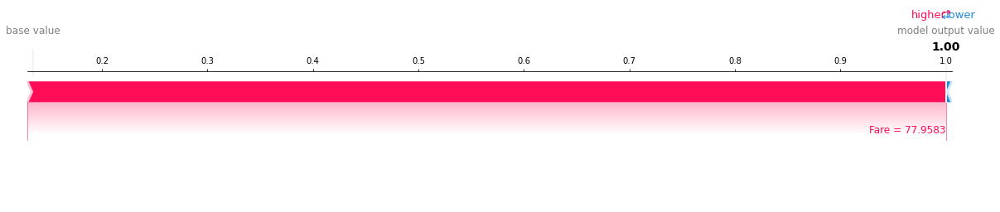


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.109', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.571', 'Calibration [Female Group]: 0.842')
Actual predictor: 1


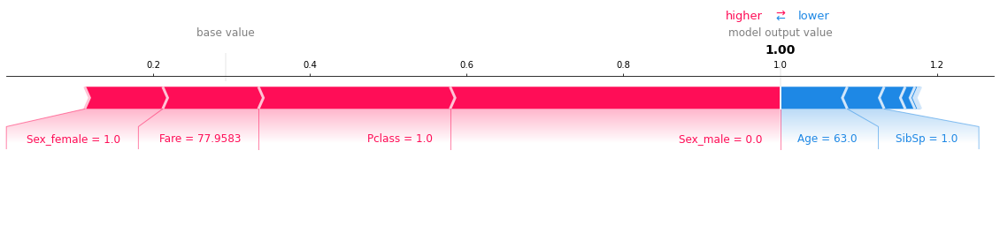


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


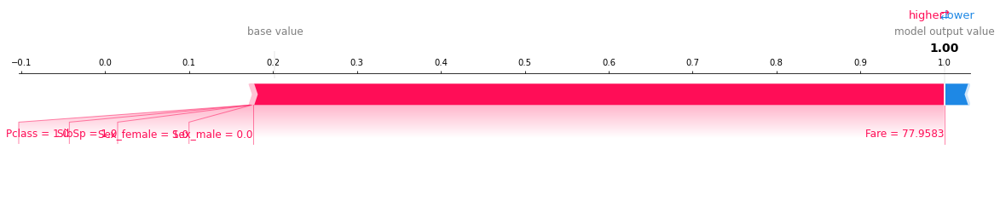


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.197', 'Statistical Parity [Female Group]: 0.821')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.913')
Actual predictor: 1


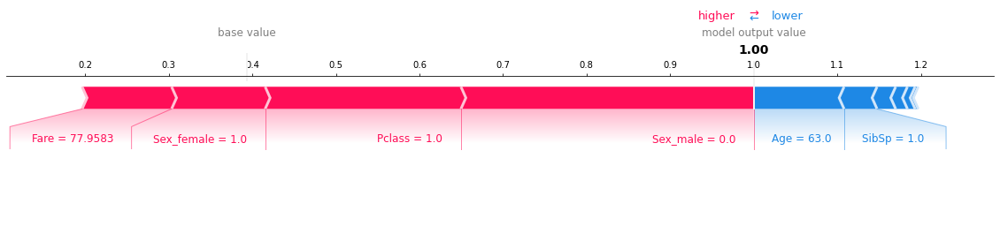


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 1


divide by zero encountered in double_scalars


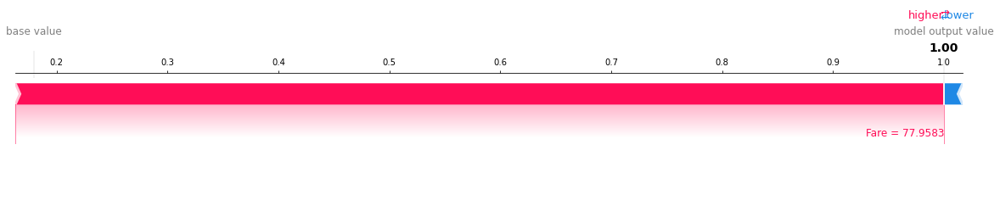


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch     Fare  Sex_female  Sex_male  Embarked_C  \
275       1  63.0      1      0  77.9583           1         0           0   

     Embarked_Q  Embarked_S  
275           0           1  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.136', 'Statistical Parity [Female Group]: 0.8')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.875', 'Calibration [Female Group]: 0.792')
Actual predictor: 1


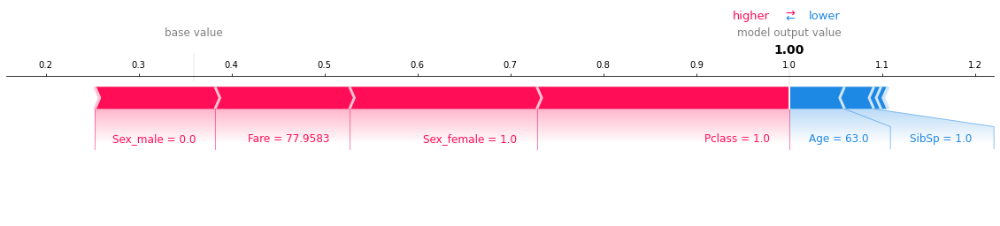


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


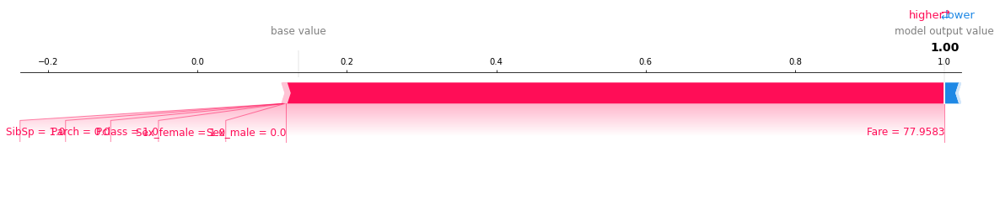

In [306]:
getInsights(female_oldage.copy())

FOLD 1


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.767
('Statistical Parity [Male Group]: 0.173', 'Statistical Parity [Female Group]: 0.763')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.833')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.862')
Actual predictor: 1


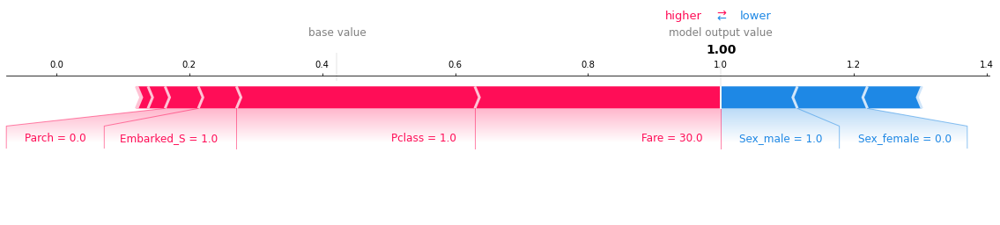


*****Accuracy SVM:  0.6
('Statistical Parity [Male Group]: 0.115', 'Statistical Parity [Female Group]: 0.184')
('Equalized Opportunity [Male Group]: 0.111', 'Equalized Opportunity [Female Group]: 0.233')
('Equalized Odds [Male Group]: 0.116', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.167', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


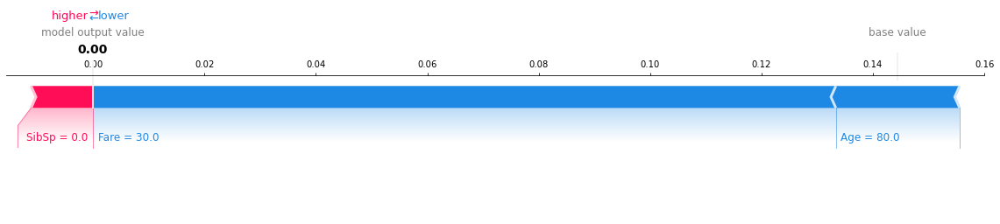


FOLD 2


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.798
('Statistical Parity [Male Group]: 0.108', 'Statistical Parity [Female Group]: 0.708')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.857')
('Calibration [Male Group]: 0.143', 'Calibration [Female Group]: 0.706')
Actual predictor: 1


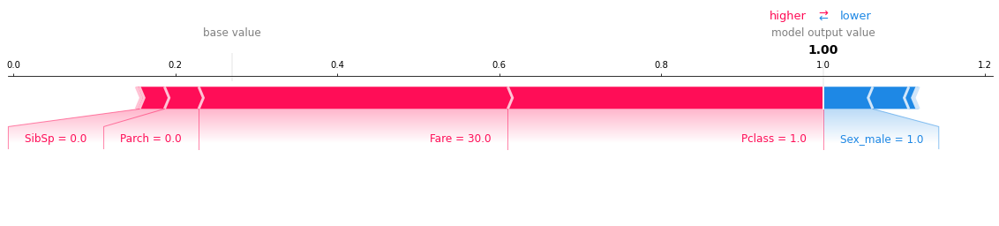


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.2', 'Statistical Parity [Female Group]: 0.083')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.143')
('Equalized Odds [Male Group]: 0.203', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.077', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


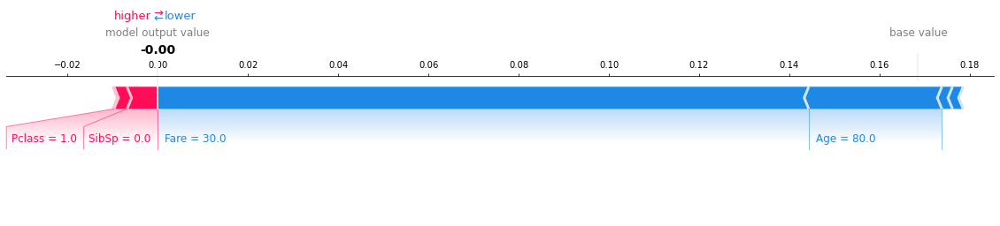


FOLD 3


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.035', 'Statistical Parity [Female Group]: 0.781')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.864')
('Calibration [Male Group]: 1.0', 'Calibration [Female Group]: 0.76')
Actual predictor: 1


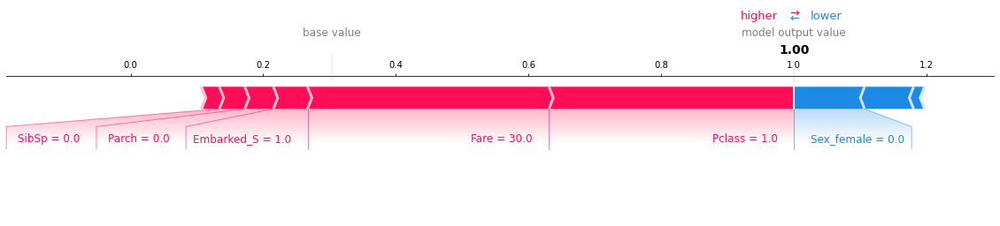


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.083', 'Equalized Opportunity [Female Group]: 0.318')
('Equalized Odds [Male Group]: 0.067', 'Equalized Odds [Female Group]: 0.1')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


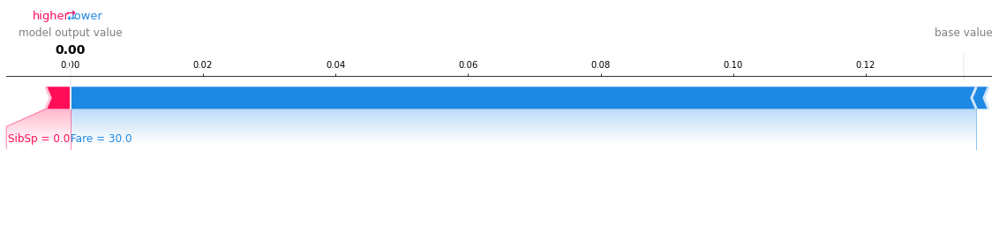


FOLD 4


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.787
('Statistical Parity [Male Group]: 0.18', 'Statistical Parity [Female Group]: 0.795')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 0.829')
('Calibration [Male Group]: 0.444', 'Calibration [Female Group]: 0.935')
Actual predictor: 1


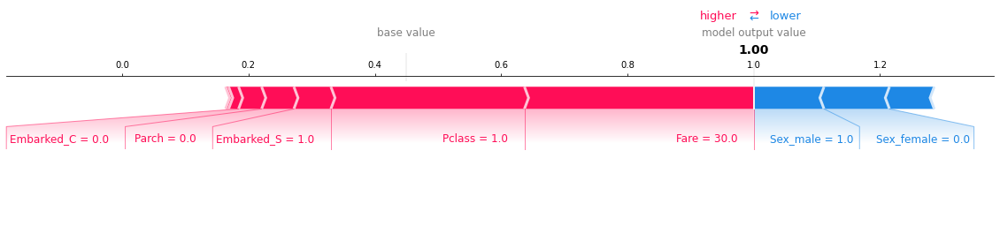


*****Accuracy SVM:  0.674
('Statistical Parity [Male Group]: 0.08', 'Statistical Parity [Female Group]: 0.513')
('Equalized Opportunity [Male Group]: 0.1', 'Equalized Opportunity [Female Group]: 0.543')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.25')
('Calibration [Male Group]: 0.25', 'Calibration [Female Group]: 0.95')
Actual predictor: 1


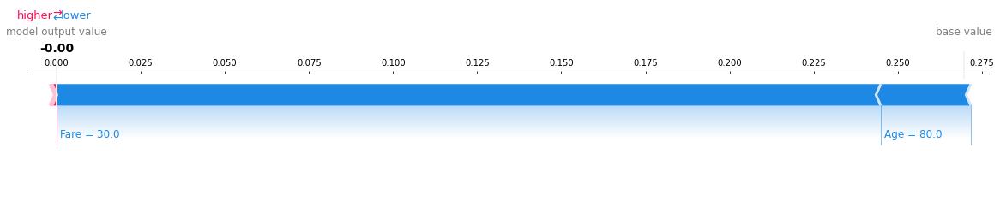


FOLD 5


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.854
('Statistical Parity [Male Group]: 0.176', 'Statistical Parity [Female Group]: 0.763')
('Equalized Opportunity [Male Group]: 0.4', 'Equalized Opportunity [Female Group]: 1.0')
('Calibration [Male Group]: 0.444', 'Calibration [Female Group]: 0.931')
Actual predictor: 1


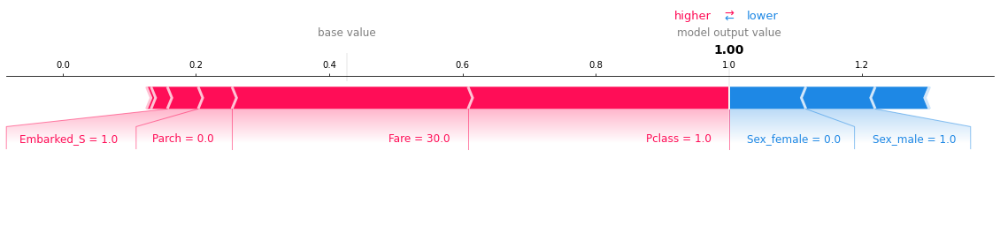


*****Accuracy SVM:  0.663
('Statistical Parity [Male Group]: 0.137', 'Statistical Parity [Female Group]: 0.211')
('Equalized Opportunity [Male Group]: 0.3', 'Equalized Opportunity [Female Group]: 0.296')
('Equalized Odds [Male Group]: 0.098', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.429', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


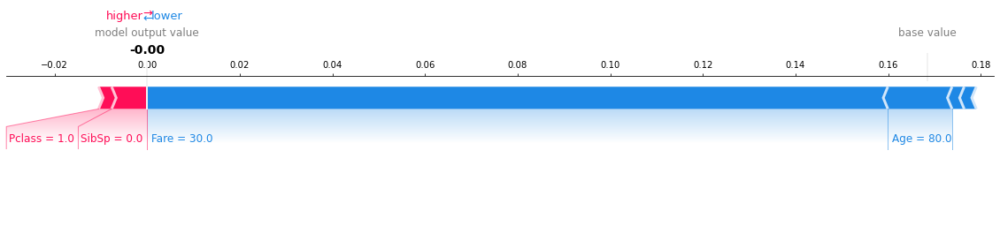


FOLD 6


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.865
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.455', 'Equalized Opportunity [Female Group]: 0.952')
('Calibration [Male Group]: 0.833', 'Calibration [Female Group]: 0.833')
Actual predictor: 1


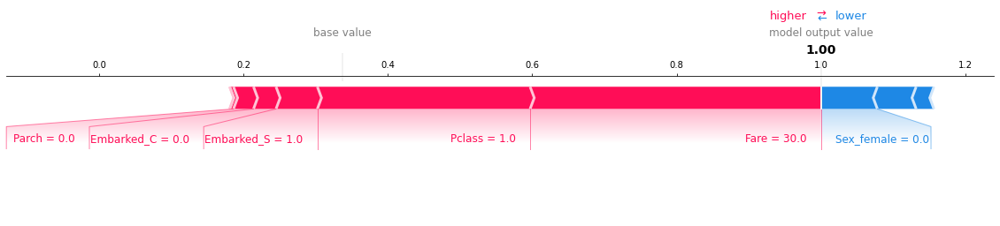


*****Accuracy SVM:  0.719
('Statistical Parity [Male Group]: 0.082', 'Statistical Parity [Female Group]: 0.286')
('Equalized Opportunity [Male Group]: 0.273', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.04', 'Equalized Odds [Female Group]: 0.143')
('Calibration [Male Group]: 0.6', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


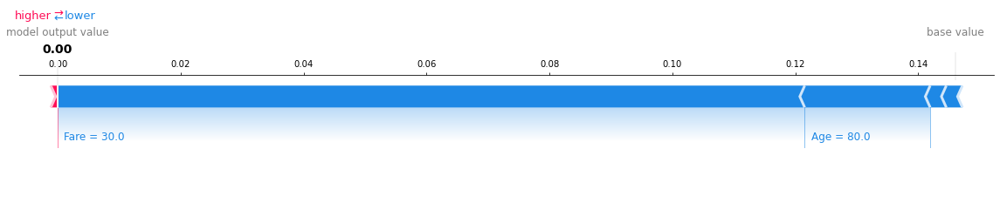


FOLD 7


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.798
('Statistical Parity [Male Group]: 0.14', 'Statistical Parity [Female Group]: 0.781')
('Equalized Opportunity [Male Group]: 0.333', 'Equalized Opportunity [Female Group]: 0.917')
('Calibration [Male Group]: 0.625', 'Calibration [Female Group]: 0.88')
Actual predictor: 1


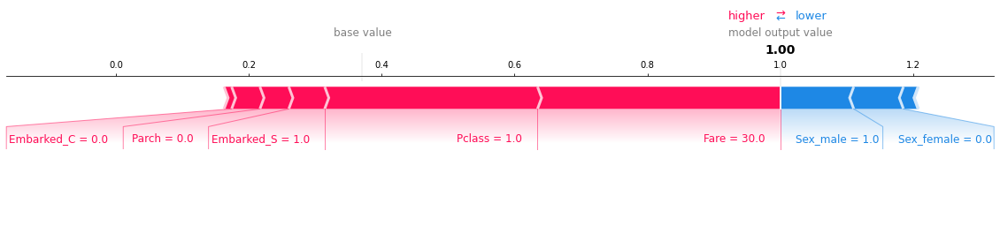


*****Accuracy SVM:  0.652
('Statistical Parity [Male Group]: 0.07', 'Statistical Parity [Female Group]: 0.25')
('Equalized Opportunity [Male Group]: 0.133', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.048', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


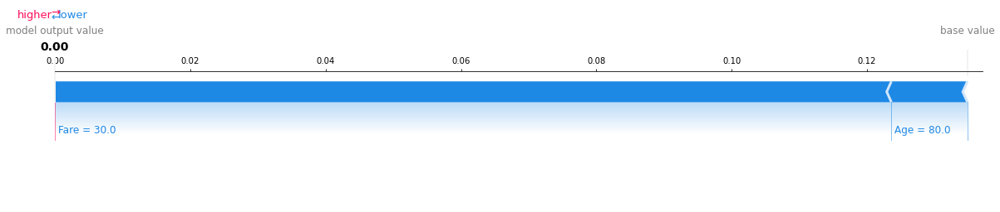


FOLD 8


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.775
('Statistical Parity [Male Group]: 0.125', 'Statistical Parity [Female Group]: 0.76')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.941')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.842')
Actual predictor: 1


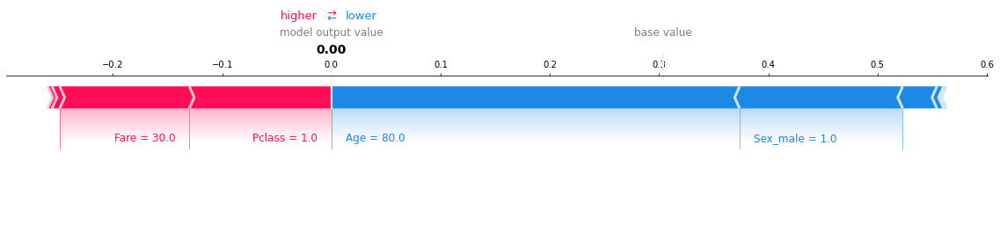


*****Accuracy SVM:  0.742
('Statistical Parity [Male Group]: 0.172', 'Statistical Parity [Female Group]: 0.28')
('Equalized Opportunity [Male Group]: 0.438', 'Equalized Opportunity [Female Group]: 0.412')
('Equalized Odds [Male Group]: 0.083', 'Equalized Odds [Female Group]: 0.0')
('Calibration [Male Group]: 0.636', 'Calibration [Female Group]: 1.0')
Actual predictor: 1


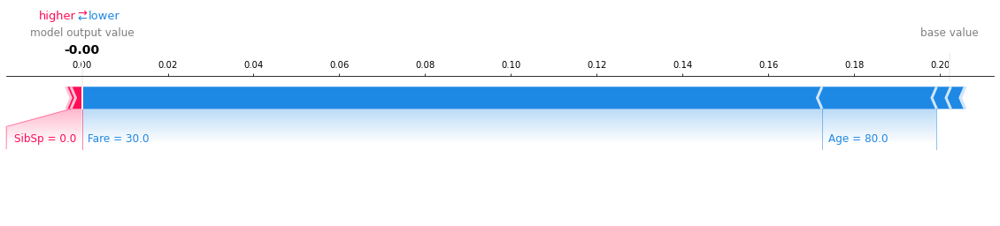


FOLD 9


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.82
('Statistical Parity [Male Group]: 0.197', 'Statistical Parity [Female Group]: 0.857')
('Equalized Opportunity [Male Group]: 0.5', 'Equalized Opportunity [Female Group]: 0.955')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


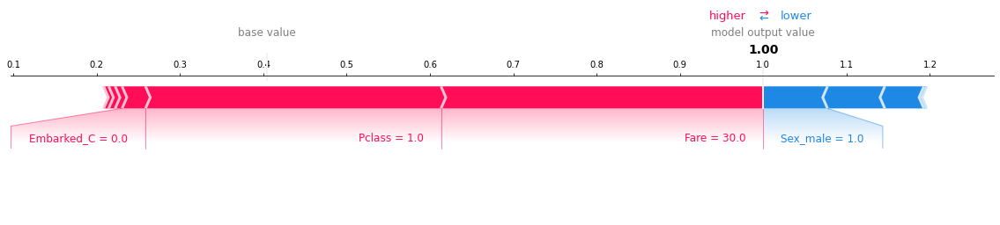


*****Accuracy SVM:  0.73
('Statistical Parity [Male Group]: 0.098', 'Statistical Parity [Female Group]: 0.357')
('Equalized Opportunity [Male Group]: 0.25', 'Equalized Opportunity [Female Group]: 0.409')
('Equalized Odds [Male Group]: 0.075', 'Equalized Odds [Female Group]: 0.167')
('Calibration [Male Group]: 0.333', 'Calibration [Female Group]: 0.9')
Actual predictor: 1


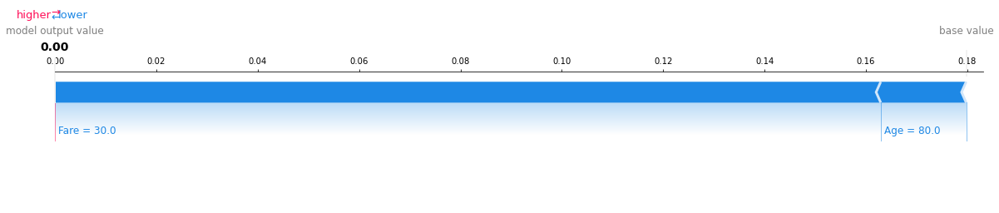


FOLD 10


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


  0%|          | 0/1 [00:00<?, ?it/s]

l1_reg="auto" is deprecated and in the next version (v0.29) the behavior will change from a conditional use of AIC to simply "num_features(10)"!


     Pclass   Age  SibSp  Parch  Fare  Sex_female  Sex_male  Embarked_C  \
630       1  80.0      0      0  30.0           0         1           0   

     Embarked_Q  Embarked_S  
630           0           1  
*****Accuracy Random Forest:  0.831
('Statistical Parity [Male Group]: 0.169', 'Statistical Parity [Female Group]: 0.8')
('Equalized Opportunity [Male Group]: 0.583', 'Equalized Opportunity [Female Group]: 0.905')
('Calibration [Male Group]: 0.7', 'Calibration [Female Group]: 0.792')
Actual predictor: 1


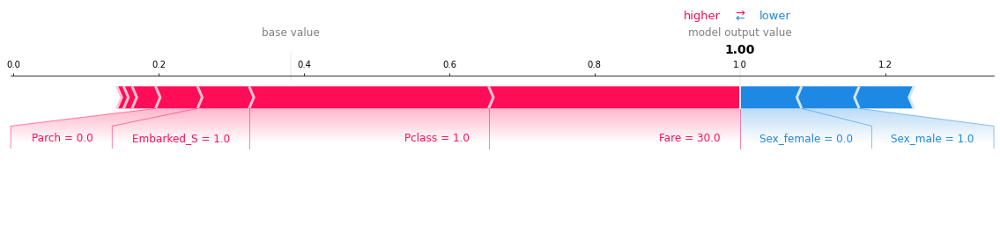


*****Accuracy SVM:  0.697
('Statistical Parity [Male Group]: 0.068', 'Statistical Parity [Female Group]: 0.267')
('Equalized Opportunity [Male Group]: 0.167', 'Equalized Opportunity [Female Group]: 0.333')
('Equalized Odds [Male Group]: 0.043', 'Equalized Odds [Female Group]: 0.111')
('Calibration [Male Group]: 0.5', 'Calibration [Female Group]: 0.875')
Actual predictor: 1


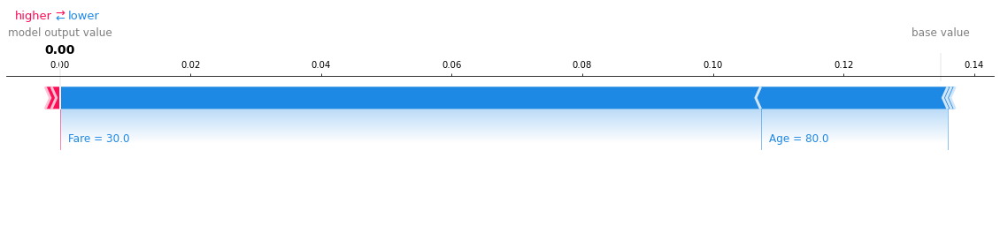

In [307]:
getInsights(male_oldage.copy())

In [294]:
print('RF: ', rf_score)
print('SVM: ', svm_score)
print()
print(np.mean([x[1] for x in rf_score]))
print(np.mean([x[1] for x in svm_score]))

RF:  [[1, 0.778], [2, 0.798], [3, 0.775], [4, 0.82], [5, 0.876], [6, 0.831], [7, 0.798], [8, 0.775], [9, 0.843], [10, 0.854]]
SVM:  [[1, 0.6], [2, 0.674], [3, 0.663], [4, 0.674], [5, 0.663], [6, 0.719], [7, 0.652], [8, 0.742], [9, 0.73], [10, 0.697]]

0.8148
0.6814000000000001


0.876
0.742


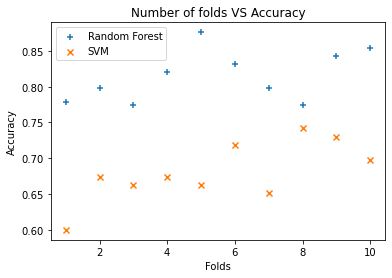

In [273]:
fig, ax = plt.subplots()
ax.scatter(pd.DataFrame(rf_score)[0], pd.DataFrame(rf_score)[1], marker='+', label='Random Forest')
ax.scatter(pd.DataFrame(svm_score)[0], pd.DataFrame(svm_score)[1], marker='x', label='SVM')
ax.set_xlabel('Folds')
ax.set_ylabel('Accuracy')
ax.set_title('Number of folds VS Accuracy')
ax.legend(loc='best')
rf_ymax = round(max(pd.DataFrame(rf_score)[1]), 3)
rf_xmax = max(pd.DataFrame(rf_score)[0])
svm_ymax = round(max(pd.DataFrame(svm_score)[1]), 3)
svm_xmax = max(pd.DataFrame(svm_score)[0])
# rf_text= "x={:.3f}, y={:.3f}".format(rf_xmax, rf_ymax)
# svm_text= "x={:.3f}, y={:.3f}".format(svm_xmax, svm_ymax)

# ax.annotate(rf_text, xy=(rf_xmax, rf_ymax), xytext=(rf_xmax+ 0.2,rf_ymax))
# ax.annotate(svm_text, xy=(svm_xmax, svm_ymax), xytext=(svm_xmax+ 0.2,svm_ymax))


print(rf_ymax)
print(svm_ymax)

## Deep Analysis - XAI only for Females

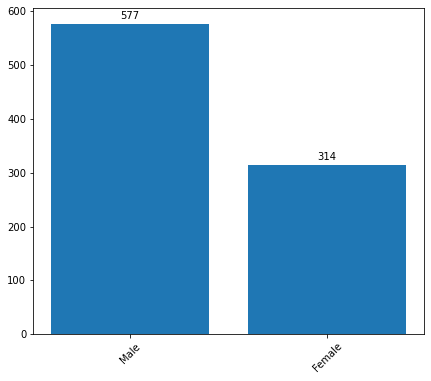

In [601]:
all_females = data[data['Sex_female'] ==1]
all_males = data[data['Sex_male'] ==1]

from pylab import rcParams
rcParams['figure.figsize'] = 7, 6

pps = pltt.bar(x=['Male', 'Female'], height=[all_males.shape[0],all_females.shape[0]])
for p in pps:
   height = p.get_height()
   pltt.annotate('{}'.format(height),
      xy=(p.get_x() + p.get_width() / 2, height),
      xytext=(0, 3), # 3 points vertical offset
      textcoords="offset points",
      ha='center', va='bottom')
pltt.xticks(rotation = 45)
pltt.show()


### RF

In [439]:
all_females = data[data['Sex_female'] ==1]
all_females.drop(['Sex_female', 'Sex_male'], 1, inplace=True)

In [448]:
train_std1, test_std1 = train_test_split(all_females, test_size=0.3, random_state=0, stratify=all_females['Survived'])
X_train_std1 = train_std1.drop(['Survived'], axis=1)
Y_train_std1 = train_std1['Survived']

X_test_std1 = test_std1.drop(['Survived'], axis=1)
Y_test_std1 = test_std1['Survived']

In [428]:
# Random Forest
rf_std1 = RandomForestClassifier(n_estimators=100)
rf_std1.fit(X_train_std1, Y_train_std1)

RandomForestClassifier()

In [429]:
rf_std1_preds = rf_std1.predict(X_test_std1)

In [430]:
print(f'Accuracy of the Random Forest model is: {accuracy_score(Y_test_std1, rf_std1_preds)}')

Accuracy of the Random Forest model is: 0.8631578947368421


In [431]:
confusion_matrix(Y_test_std1, rf_std1_preds)

array([[16,  9],
       [ 4, 66]])

#### SHAP

In [434]:
shap_explainer = shap.KernelExplainer(rf_std1.predict, X_train_std1)
shap_test_data = X_test_std1#[X_test_std1.columns[:10]][:10]

Using 219 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [435]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/95 [00:00<?, ?it/s]

In [436]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)


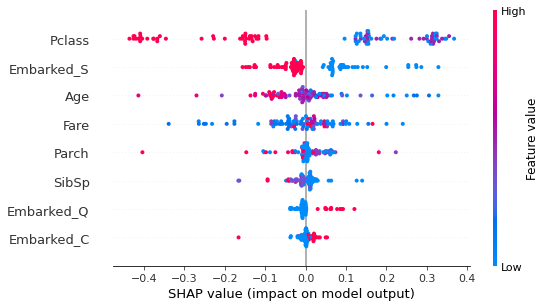

In [437]:
shap.summary_plot(shap_values, shap_test_data)

**Here we can see that Pclass is the most important feature**

### SVM

In [480]:
svm_model_std1 = SVC()
svm_model_std1.fit(X_train_std1, Y_train_std1)

SVC()

In [479]:
train_std1, test_std1 = train_test_split(all_females, test_size=0.3, random_state=0, stratify=all_females['Survived'])
X_train_std1 = train_std1.drop(['Survived'], axis=1)
Y_train_std1 = train_std1['Survived']

X_test_std1 = test_std1.drop(['Survived'], axis=1)
Y_test_std1 = test_std1['Survived']

In [481]:
svm_std1_preds = svm_model_std1.predict(X_test_std1)
print(f'Accuracy of the SVM is: {accuracy_score(Y_test_std1, svm_std1_preds)}')

Accuracy of the SVM is: 0.7368421052631579


In [483]:
confusion_matrix(Y_test_std1, svm_std1_preds)

array([[ 0, 25],
       [ 0, 70]])

#### SHAP

In [484]:
shap.initjs()

In [485]:
shap_explainer = shap.KernelExplainer(svm_model_std1.predict, X_train_std1)
shap_test_data = X_test_std1#[X_test_std1.columns[:10]][:10]

Using 219 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [486]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/95 [00:00<?, ?it/s]

In [490]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)


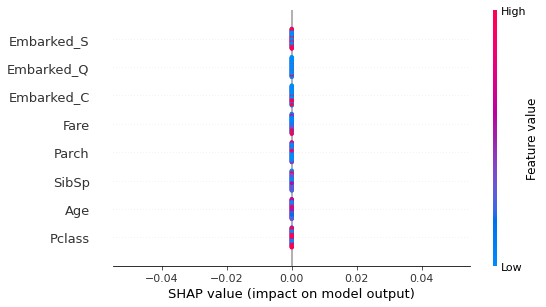

In [491]:
shap.summary_plot(shap_values, shap_test_data)

## Deep Analysis - XAI only for Males

### RF

In [488]:
all_males = data[data['Sex_male'] ==1]
all_males.drop(['Sex_female', 'Sex_male'], 1, inplace=True)

In [492]:
train_std1, test_std1 = train_test_split(all_males, test_size=0.3, random_state=0, stratify=all_males['Survived'])
X_train_std1 = train_std1.drop(['Survived'], axis=1)
Y_train_std1 = train_std1['Survived']

X_test_std1 = test_std1.drop(['Survived'], axis=1)
Y_test_std1 = test_std1['Survived']

In [493]:
# Random Forest
rf_std1 = RandomForestClassifier(n_estimators=100)
rf_std1.fit(X_train_std1, Y_train_std1)

RandomForestClassifier()

In [494]:
rf_std1_preds = rf_std1.predict(X_test_std1)

In [495]:
print(f'Accuracy of the Random Forest model is: {accuracy_score(Y_test_std1, rf_std1_preds)}')

Accuracy of the Random Forest model is: 0.7816091954022989


In [496]:
confusion_matrix(Y_test_std1, rf_std1_preds)

array([[122,  19],
       [ 19,  14]])

#### SHAP

In [497]:
shap_explainer = shap.KernelExplainer(rf_std1.predict, X_train_std1)
shap_test_data = X_test_std1#[X_test_std1.columns[:10]][:10]

Using 403 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [498]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/174 [00:00<?, ?it/s]

In [499]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)


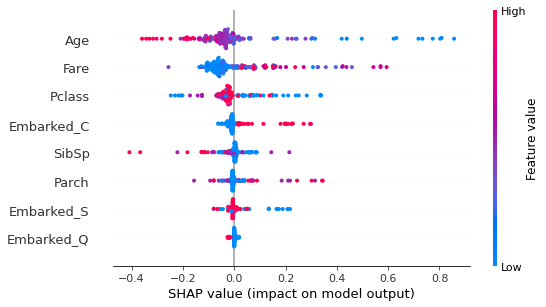

In [500]:
shap.summary_plot(shap_values, shap_test_data)

**Here we can see that Age is the most important feature for Random Forest model**

#### SVM

In [502]:
svm_model_std1 = SVC()
svm_model_std1.fit(X_train_std1, Y_train_std1)

SVC()

In [503]:
svm_std1_preds = svm_model_std1.predict(X_test_std1)

In [504]:
print(f'Accuracy of the SVM is: {accuracy_score(Y_test_std1, svm_std1_preds)}')

Accuracy of the SVM is: 0.8160919540229885


In [505]:
confusion_matrix(Y_test_std1, svm_std1_preds)

array([[141,   0],
       [ 32,   1]])

#### SHAP

In [507]:
shap_explainer = shap.KernelExplainer(svm_model_std1.predict, X_train_std1)
shap_test_data = X_test_std1#[X_test_std1.columns[:10]][:10]

Using 403 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


In [508]:
shap_values = shap_explainer.shap_values(shap_test_data)

  0%|          | 0/174 [00:00<?, ?it/s]

In [509]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)

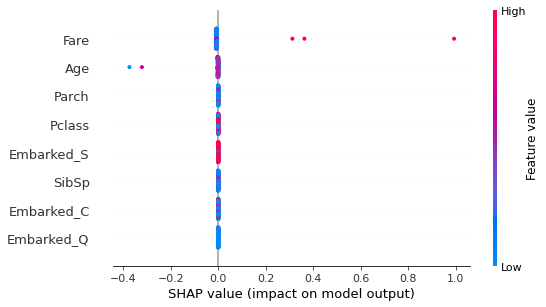

In [510]:
shap.summary_plot(shap_values, shap_test_data)

**Here we can see that Fare is the most important feature for Random Forest model**

## Deep Analysis - XAI by Age groups

We are going to divide our dataset in below standard age groups

1. Children--> 0-14 years
2. Youth --> 15-24 years
3. Adults --> 25-64 years
4. Seniors --> 65 and over

In [559]:
children_df = data[(data['Age'] >= 0) & (data['Age'] <= 14)]
print(f'Number of Children: {children_df.shape[0]}')

youth_df = data[(data['Age'] >= 15) & (data['Age'] <= 24)]
print(f'Number of Youth: {youth_df.shape[0]}')

adult_df = data[(data['Age'] >= 25) & (data['Age'] <= 64)]
print(f'Number of Adult: {adult_df.shape[0]}')

senior_df = data[(data['Age'] >= 65)]
print(f'Number of Senior: {senior_df.shape[0]}')

Number of Children: 77
Number of Youth: 199
Number of Adult: 602
Number of Senior: 11


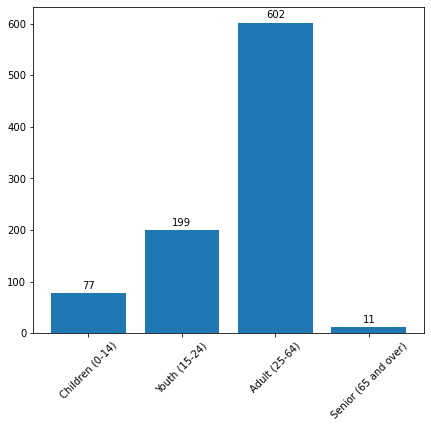

In [587]:
# plt.bar([['Children', 77], ['Youth', 199], ['Adult', 602], ['Senior', 11]], height=12)
from pylab import rcParams
rcParams['figure.figsize'] = 7, 6

pps = pltt.bar(x=['Children (0-14)', 'Youth (15-24)','Adult (25-64)', 'Senior (65 and over)'], height=[77,199,602,11])
for p in pps:
   height = p.get_height()
   pltt.annotate('{}'.format(height),
      xy=(p.get_x() + p.get_width() / 2, height),
      xytext=(0, 3), # 3 points vertical offset
      textcoords="offset points",
      ha='center', va='bottom')
pltt.xticks(rotation = 45)
pltt.show()

In [556]:
def produce_results(input_data):
#     if 'Age' in children_df.columns:
#         input_data.drop('Age', 1, inplace=True)

#     Split the dataset
    train_std2, test_std2 = train_test_split(input_data, test_size=0.3, random_state=0, stratify=input_data['Survived'])
    X_train_std2 = train_std2.drop(['Survived'], axis=1)
    Y_train_std2 = train_std2['Survived']

    X_test_std2 = test_std2.drop(['Survived'], axis=1)
    Y_test_std2 = test_std2['Survived']
    
    
    
#     Random Forest
    rf_std2 = RandomForestClassifier(n_estimators=100)
    rf_std2.fit(X_train_std2, Y_train_std2)
    
#     Predictions
    rf_std2_preds = rf_std2.predict(X_test_std2)
    
#     Accuracy
    print(f'Accuracy of the Random Forest model is: {accuracy_score(Y_test_std2, rf_std2_preds)}')
    
#     Confusion Matrix
    confusion_matrix(Y_test_std2, rf_std2_preds)
    
    
#     SHAPely values analysis
    shap_explainer = shap.KernelExplainer(rf_std2.predict, X_train_std2)
    shap_test_data = X_test_std2#[X_test_std1.columns[:10]][:10]
    shap_values = shap_explainer.shap_values(shap_test_data)
#     shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data, matplotlib=True)

#     shap.summary_plot(shap_values, shap_test_data)
    return shap_explainer.expected_value, shap_values, shap_test_data
    

In [557]:
# For Children--> 0-14 years
shap_explainer.expected_value, shap_values, shap_test_data = produce_results(children_df)
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)

Accuracy of the Random Forest model is: 0.875


  0%|          | 0/24 [00:00<?, ?it/s]

**The two halves of the data are dominated by SibSp feature.**

**We can see that for the 0-14 Age group the RF model gives more weightage to whether the person had siblings or spouse with them**

**If the person has sibling or spouse with them then they have high chances of survival in the half of the data while in other half the same feature is dragging the prediction towards 0.**

In [558]:
# For Youth--> 15-24 years
shap_explainer.expected_value, shap_values, shap_test_data = produce_results(youth_df)
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)

Using 139 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Accuracy of the Random Forest model is: 0.7833333333333333


  0%|          | 0/60 [00:00<?, ?it/s]

For youth Random Forest model is giving importance to **Gender**.

For half of the data person being male drags the prediciton **towards survival** while for other half of the data person being male **reduces** his chances of survival.

In [589]:
# For Adult--> 25-64 years
shap_explainer.expected_value, shap_values, shap_test_data = produce_results(adult_df)

Using 421 background data samples could cause slower run times. Consider using shap.sample(data, K) or shap.kmeans(data, K) to summarize the background as K samples.


Accuracy of the Random Forest model is: 0.7955801104972375


  0%|          | 0/181 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [596]:
shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)

For Adults, we can clearly see 5 regions in our dataset.

1. Region1: **PClass, Fare, Age and SibSp** is dragging the prediction towards the survival while **Gender** is not that important.
2. Region2: **PClass** is the **least important feature** for dragging prediciton towards survival while other features were significant for predicting not survival of the individual.
3. Region3: **Age, SibSp** are the least important features and is dragging the predicition towards 0, while other features are pushing the prediction towards 1.
4. Region4: **Gender** is not that inmportant feature for pushing prediction towards survival, whereas **SibSp, PClass** are majorly pushing the prediction towards not survival.
5. Region5: **PClass and Fare** are least important while **Age and Gender** are most important features.

In [599]:
# For Senior--> 64 and over years
# shap_explainer.expected_value, shap_values, shap_test_data = produce_results(senior_df)
# shap.force_plot(shap_explainer.expected_value, shap_values, shap_test_data)
senior_df

,Survived,Pclass,Age,SibSp,Parch,Fare,Sex_female,Sex_male,Embarked_C,Embarked_Q,Embarked_S
33,0,2,66.0,0,0,10.5000,0,1,0,0,1
54,0,1,65.0,0,1,61.9792,0,1,1,0,0
96,0,1,71.0,0,0,34.6542,0,1,1,0,0
116,0,3,70.5,0,0,7.7500,0,1,0,1,0
280,0,3,65.0,0,0,7.7500,0,1,0,1,0
456,0,1,65.0,0,0,26.5500,0,1,0,0,1
493,0,1,71.0,0,0,49.5042,0,1,1,0,0
630,1,1,80.0,0,0,30.0000,0,1,0,0,1
672,0,2,70.0,0,0,10.5000,0,1,0,0,1
745,0,1,70.0,1,1,71.0000,0,1,0,0,1


In senior citizens, we have **only one survival** and the records are not sufficient for the analysis.

In [217]:
arr = [['a',1],['b',2]]
arr = pd.DataFrame(arr, label)
arr[0]

pandas.core.series.Series

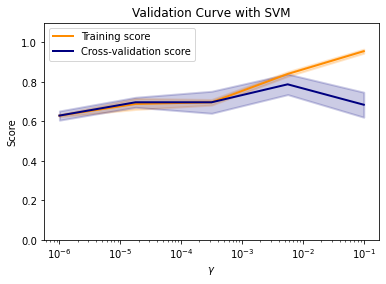

In [283]:
from sklearn.model_selection import validation_curve
param_range = np.logspace(-6, -1, 5)
data
train_scores, test_scores = validation_curve(
    SVC(), X_test, y_test, param_name="gamma", param_range=param_range,
    scoring="accuracy", n_jobs=1)
train_scores_mean = np.mean(train_scores, axis=1)
train_scores_std = np.std(train_scores, axis=1)
test_scores_mean = np.mean(test_scores, axis=1)
test_scores_std = np.std(test_scores, axis=1)

plt.title("Validation Curve with SVM")
plt.xlabel(r"$\gamma$")
plt.ylabel("Score")
plt.ylim(0.0, 1.1)
lw = 2
plt.semilogx(param_range, train_scores_mean, label="Training score",
             color="darkorange", lw=lw)
plt.fill_between(param_range, train_scores_mean - train_scores_std,
                 train_scores_mean + train_scores_std, alpha=0.2,
                 color="darkorange", lw=lw)
plt.semilogx(param_range, test_scores_mean, label="Cross-validation score",
             color="navy", lw=lw)
plt.fill_between(param_range, test_scores_mean - test_scores_std,
                 test_scores_mean + test_scores_std, alpha=0.2,
                 color="navy", lw=lw)
plt.legend(loc="best")
plt.show()

In [140]:
inp = [10,7,-3,-10,4,2,8,-2,4,-5,-6]
# inp = [9,-2,1,-3,4,-1,2,1,-5,4]
days = inp[0]
vals = inp[1:]
rec = []
for start in range(len(vals)):
    for end in range(start, len(vals)):
        rec.append([sum(vals[start:end]), start+1, end])

rec.sort(reverse=True)
rec
    

[7, -3, -10, 4, 2, 8, -2, 4, -5, -6]


[[16, 4, 8],
 [14, 4, 6],
 [12, 5, 8],
 [12, 4, 7],
 [11, 4, 9],
 [10, 6, 8],
 [10, 5, 6],
 [10, 1, 8],
 [8, 6, 6],
 [8, 5, 7],
 [8, 1, 6],
 [7, 5, 9],
 [7, 1, 1],
 [6, 6, 7],
 [6, 4, 5],
 [6, 3, 8],
 [6, 1, 7],
 [5, 6, 9],
 [5, 1, 9],
 [4, 8, 8],
 [4, 4, 4],
 [4, 3, 6],
 [4, 1, 2],
 [3, 2, 8],
 [2, 7, 8],
 [2, 5, 5],
 [2, 3, 7],
 [1, 3, 9],
 [1, 2, 6],
 [0, 10, 9],
 [0, 9, 8],
 [0, 8, 7],
 [0, 7, 6],
 [0, 6, 5],
 [0, 5, 4],
 [0, 4, 3],
 [0, 3, 2],
 [0, 2, 1],
 [0, 1, 5],
 [0, 1, 0],
 [-1, 8, 9],
 [-1, 2, 7],
 [-2, 7, 7],
 [-2, 2, 9],
 [-2, 1, 4],
 [-3, 7, 9],
 [-3, 2, 2],
 [-4, 3, 5],
 [-5, 9, 9],
 [-6, 3, 4],
 [-6, 1, 3],
 [-7, 2, 5],
 [-9, 2, 4],
 [-10, 3, 3],
 [-13, 2, 3]]

In [323]:
def even(start, n):
    if start % 2 != 0:
        return list(range(start+1, start+2*n+1, 2))
    else:
        return list(range(start, start+2*n+1, 2))
print(even(2, 4))

[2, 4, 6, 8, 10]
